In [ ]:
### This script enables exploratory investigation of traces, but does not produce any final figures. 

In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline
%load_ext line_profiler
# %pdb

import os
from IPython.core.debugger import set_trace
from matplotlib import pyplot as plt
from matplotlib import gridspec
import numpy as np
import time
import scipy.stats

import h5py
from scipy.ndimage.filters import gaussian_filter1d
from sklearn.cluster.bicluster import SpectralCoclustering
from sklearn.cluster import DBSCAN
from sklearn.metrics import consensus_score


import cosmos.traces.trace_analysis_utils as utils
from cosmos.behavior.bpod_dataset import BpodDataset
import cosmos.imaging.atlas_registration as reg
from cosmos.traces.cell_plotter import CellPlotter
from cosmos.traces.cosmos_traces import CosmosTraces

import cosmos.params.trace_analyze_params as params 

In [2]:
%pdb

Automatic pdb calling has been turned ON


In [3]:
# Select dataset.
workstation = 'analysis2' #'analysis2'
if workstation == 'analysis2':
    data_dir = '/home/izkula/Dropbox/cosmos_data/'
    fig_save_dir = '/home/izkula/Dropbox/cosmos/trace_analysis/'
    bpod_dir = '/home/izkula/Dropbox/cosmos_data/behavior/'
elif workstation == 'cosmosdata':
    data_dir = '/home/user/Dropbox/cosmos_data/'
    fig_save_dir = '/home/user/Dropbox/cosmos/trace_analysis/'
    bpod_dir = '/home/user/Dropbox/cosmos_data/behavior/'

### Good datasets:
### 7 (m72 good), 22 (m72 okay), 23 (m72 okay, fewer cells than 22),  
### 11 (m943 good), 25 (m943 good/ok), 24 (m943 ok), 
### 18 (m945 good), 27 (m945 pretty good)
### 19 (m194 good), 21 (m194 okay, needs fixing - potentially not use if imp),  
dataset_id = 11 #7 #11 #12
dataset = params.DATASETS[dataset_id]
print(dataset)
dataset['data_root'] = data_dir
dataset['fig_save_dir'] = fig_save_dir
dataset['behavior_dir'] = bpod_dir

{'bpod_file': 'cux2m943/COSMOSTrainMultiBlockGNG/Session Data/cux2m943_COSMOSTrainMultiBlockGNG_20180420_130634.mat', 'info': '***This has good behavior. 1084 sources', 'regressors_name': 'cux2m943-20180420-130639', 'date': '20180420', 'name': 'cux2ai148m943_COSMOSTrainMultiBlockGNG_1'}


(1/3) Loading trace data.
(2/3) Loading behavior data.
While loading bpod, enforcing that ntrials is:194
lick rates bin size: 0.034
lick rates bin size: 0.034
lick rates bin size: 0.034
lick rates bin size: 0.034
Saving to:  /home/izkula/Dropbox/cosmos/trace_analysis/20180420/cux2ai148m943_COSMOSTrainMultiBlockGNG_1/polar_pre-reward.pdf
Saving to:  /home/izkula/Dropbox/cosmos/trace_analysis/20180420/cux2ai148m943_COSMOSTrainMultiBlockGNG_1/polar_post-reward.pdf
Saving to:  /home/izkula/Dropbox/cosmos/trace_analysis/20180420/cux2ai148m943_COSMOSTrainMultiBlockGNG_1/licks.pdf
Saving to:  /home/izkula/Dropbox/cosmos/trace_analysis/20180420/cux2ai148m943_COSMOSTrainMultiBlockGNG_1/success_rate.pdf
LED trials: 195
Processing traces.
[ -0.98693836 480.98693836]
[346.31439921 364.68560079]
Elapsed time: 20.107519388198853


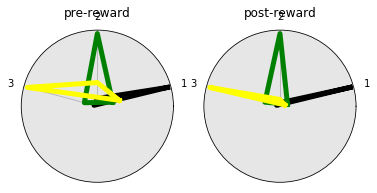

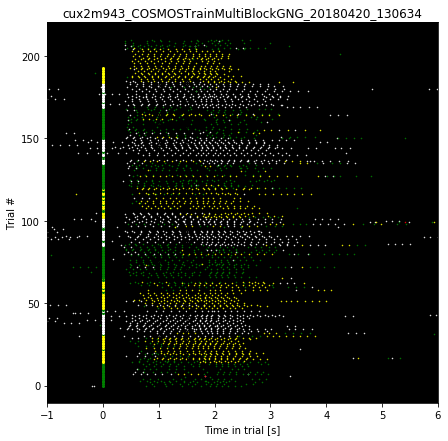

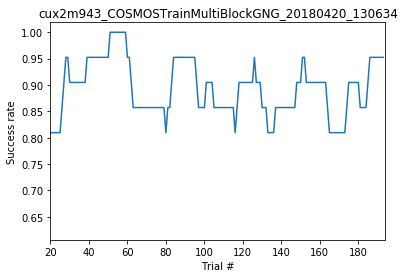

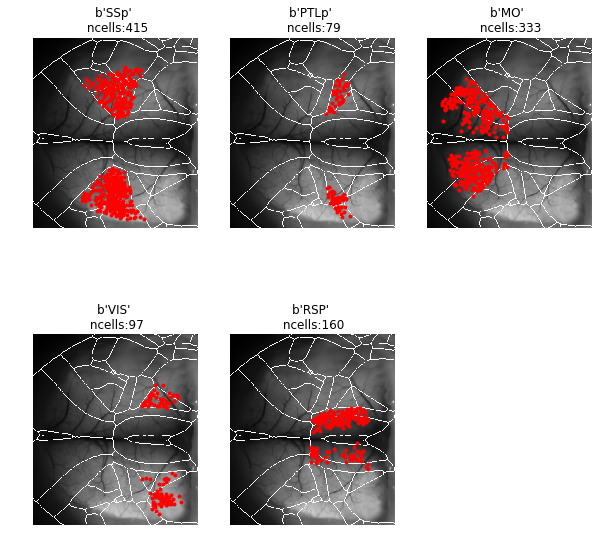

In [4]:
# Load data.
startt = time.time()

CT = CosmosTraces(dataset, do_region_plots=True)
BD = CT.bd

print('Elapsed time: '+str(time.time() - startt))

# TODO : Plot atlas overlay to check that it looks good. 

In [5]:
# Setup some analysis specific variables.
smooth_spikes = gaussian_filter1d(CT.St, 1.5, axis=1, mode='constant')

# Define trial sets.
use_all_trials = True

if use_all_trials:
    clean_trials = np.ones(BD.success.shape)
    min_block_trial = 0
else:
    clean_trials = np.zeros(BD.success.shape)
    clean_trials[BD.get_clean_trials(min_selectivity=0.95)] = 1
    min_block_trial = 7

lick_spout1 = np.logical_and.reduce((BD.go_trials.astype('bool'), 
                                     BD.success, 
                                     BD.spout_positions==1,
                                     BD.ind_within_block>=min_block_trial,
                                     clean_trials))
lick_spout3 = np.logical_and.reduce((BD.go_trials.astype('bool'), 
                                     BD.success, 
                                     BD.spout_positions==3,
                                     BD.ind_within_block>=min_block_trial, 
                                     clean_trials))
lick_spout4 = np.logical_and.reduce((BD.go_trials.astype('bool'), 
                                     BD.success, 
                                     BD.spout_positions==4,
                                     BD.ind_within_block>=min_block_trial, 
                                     clean_trials))
nolick = np.logical_and.reduce((~BD.go_trials.astype('bool'), 
                                BD.success))

trial_sets = (lick_spout1, lick_spout3, lick_spout4, nolick)

False
---Plotting contours: 8.795262813568115 seconds ---


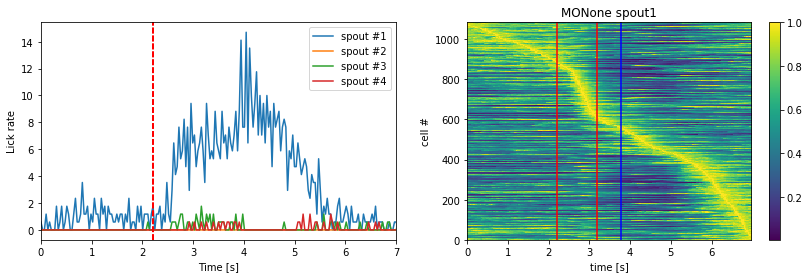

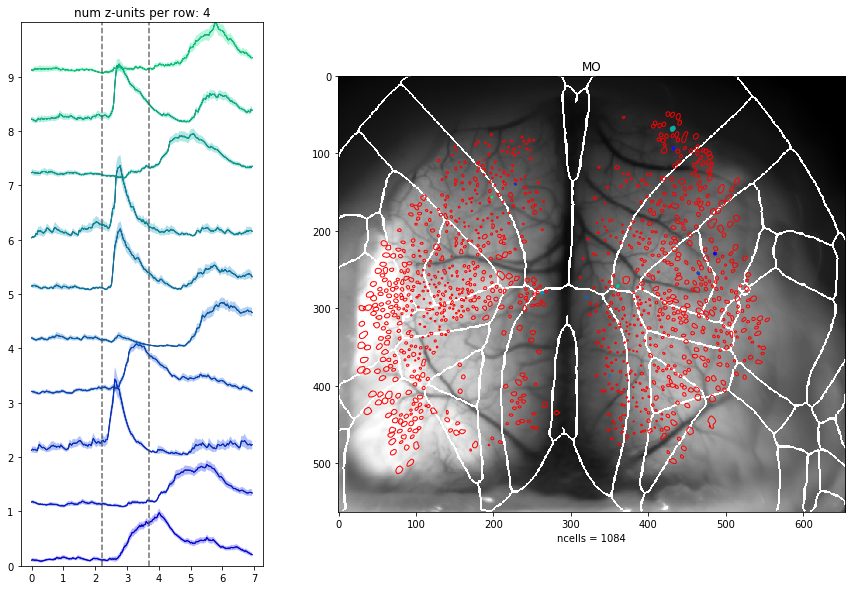

In [6]:
# Make general summary plots for specified cells and trials. 

# Select cells and regions.
region = 'MO'
hemisphere = None #0
spout_num = 1
which_cells = np.array(CT.cells_in_region[CT.regions[region]])
#which_cells = good_cells
if hemisphere is not None:
    which_cells = which_cells[np.where(CT.hemisphere_of_cell[which_cells]==hemisphere)[0]]
    
use_all_cells = True
if use_all_cells:
    which_cells = np.arange(np.shape(CT.Ct)[0])

lick_spout_trials = np.logical_and.reduce((BD.go_trials.astype('bool'), 
                                            BD.success, 
                                            BD.spout_positions==spout_num))

# Generate trial averages for specified trials and cells.
trials = lick_spout_trials
trials = trials[:CT.Ct.shape[2]]
traces = CT.Ct[which_cells,:,:][:,:,trials[:]]
footprints = CT.footprints[:,:,which_cells]
trial_means = np.mean(traces, axis=2)
trial_sems = scipy.stats.sem(traces, axis=2)


# Make plots.
plt.figure(figsize=(14,4))
BD.plot_mean_lick_rates(trials, ax=plt.subplot('121'))
plt.gca().set_xlim([0, 7])
ordering1 = utils.plot_average_trial_raster(trial_means, 
                                            bpod_data=CT.bd, 
                                            ordering='peak', 
                                            do_normalize=True, 
                                            dt = CT.dt,
                                            ax=plt.subplot('122'), 
                                            title=region+str(hemisphere)
                                                  +' spout'+str(spout_num))
ordering = CT.plot_variance_shaded_traces(trial_means, trial_sems, 
                                          cell_inds=np.arange(10, 20), # Set this
                                          footprints=footprints,
                                          ordering='var', 
                                          title=region) 
plt.savefig(os.path.join(CT.fig_save_path, 'overview.pdf'), transparent=True, rasterized=True, dpi=600)


In [7]:
### Compute session performance.
np.sum(CT.bd.success)/len(CT.bd.success)

0.8917525773195877

In [8]:
# Generate videos where each cell is represented by a circle centered on the centroid
# of its ROI, and the size/alpha/color correspond to its activity.

do_generate_centroid_videos = False
do_test_visual_stim = False # Set true when using m72_vis_stim_2

if do_generate_centroid_videos:
    if do_test_visual_stim:
        ### Testing out centroid_movie with visual stim
        rates = gaussian_filter1d(CT.St, 1.5, axis=1, mode='constant')
        mean_vid = np.mean(rates[:,:,:], axis=2)

        mean_vid = scipy.stats.zscore(mean_vid, axis=1)
        save_dir = os.path.join(fig_save_dir, 'mean_vids', 'vis')
        if not os.path.isdir(save_dir):
            os.makedirs(save_dir)
        utils.centroid_movie(mean_vid, np.arange(mean_vid.shape[0]), CT.centroids, CT.atlas_tform, max_radius=500,
                              save_dir=save_dir, do_square=False)   

    else:
        trial_types = (lick_spout1, lick_spout3, lick_spout4)
        trial_names = ['spout1', 'spout3', 'spout4']

        rates = gaussian_filter1d(CT.St, 1.5, axis=1, mode='constant')

        for ind, trials in enumerate(trial_types):
            save_dir = os.path.join(fig_save_dir, 'mean_vids', str(dataset_id), trial_names[ind])
            if not os.path.isdir(save_dir):
                os.makedirs(save_dir)

            mean_vid = np.mean(rates[:,:,trials], axis=2)
        #     mean_vid = np.mean(CT.Ct[:,:,trials], axis=2)

        #     mean_vid = mean_vid/np.expand_dims(np.max(mean_vid, axis=1), axis=1)
            mean_vid = scipy.stats.zscore(mean_vid, axis=1)
            title_list = ['BASELINE']*int(np.floor(CT.event_frames[1]))
            title_list.extend(['ODOR']*30)
            title_list.extend(['']*15)
            title_list.extend(['REWARD']*30)
            title_list.extend(['']*(mean_vid.shape[1]-len(title_list)))
            utils.centroid_movie(mean_vid, np.arange(mean_vid.shape[0]), CT.centroids, CT.atlas_tform, max_radius=50,
                                 save_dir=save_dir, title_list=title_list)
        #     if ind == 1:
        #         break

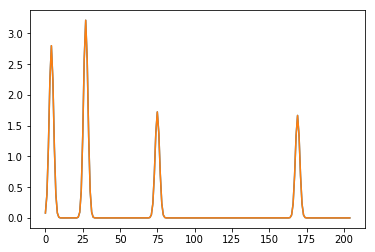

In [9]:
### Set rates here (i.e. could use fluorescence or spikes)
rates = smooth_spikes
rates_flat = np.reshape(rates, (rates.shape[0], rates.shape[1]*rates.shape[2]), order='F')

# Double check that the reshaping is correct
plt.plot(rates_flat[1,205:410])
plt.plot(rates[1,:,1])

In [10]:
# Get distance matrix so can define peers as neurons greater than some distance away.
nneurons = rates.shape[0]
distances = np.zeros((nneurons, nneurons))
for neuron in range(nneurons):
    cc = CT.centroids[neuron,:]
    diff = CT.centroids - cc
    distances[neuron,:] = np.sqrt(diff[:, 0]**2 + diff[:, 1]**2)

In [11]:
event_frames = CT.fps*np.array([0, BD.stimulus_times[0], 
                             BD.stimulus_times[0]+1.5])
print(event_frames)

[  0.          64.68288241 108.7848477 ]


In [12]:
# from rastermap import mapping
# ops = {'nclust': 30, # number of clusters
#        'iPC': np.arange(0,200).astype(np.int32), # number of PCs to use for mapping algorithm
#        'upsamp': 100, # upsampling factor for embedding position
#        'sigUp': 1, # standard deviation for kriging upsampling
#        'equal': False # whether or not clusters should be of equal size (recommended False!)
#        }
# # user options
# isort1,isort2 = mapping.main(CT.S,ops)
# plt.figure(figsize=(20, 20))
# plt.imshow(gaussian_filter1d(CT.S[isort1,:20000], 1, axis=1), aspect='auto', cmap='gray_r', clim=[0, 2])

In [47]:
CT.fig_save_path

'/home/izkula/Dropbox/cosmos/trace_analysis/20180420/cux2ai148m943_COSMOSTrainMultiBlockGNG_1'

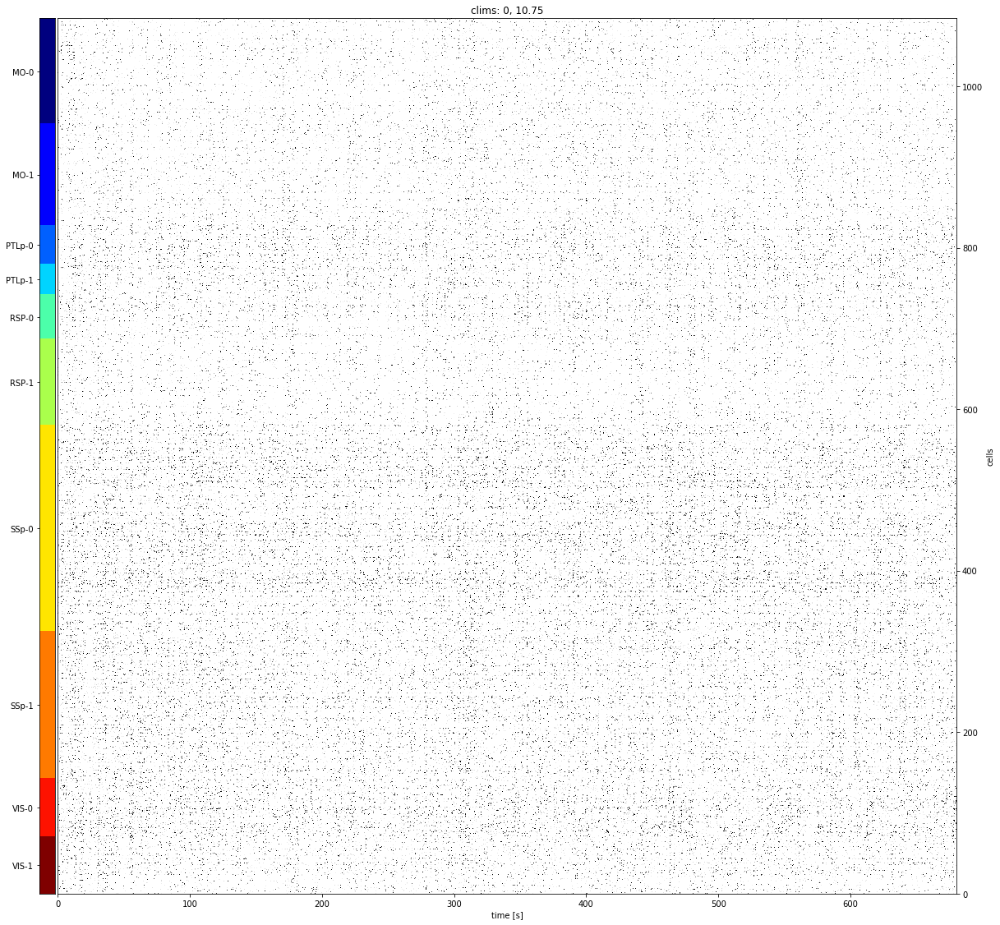

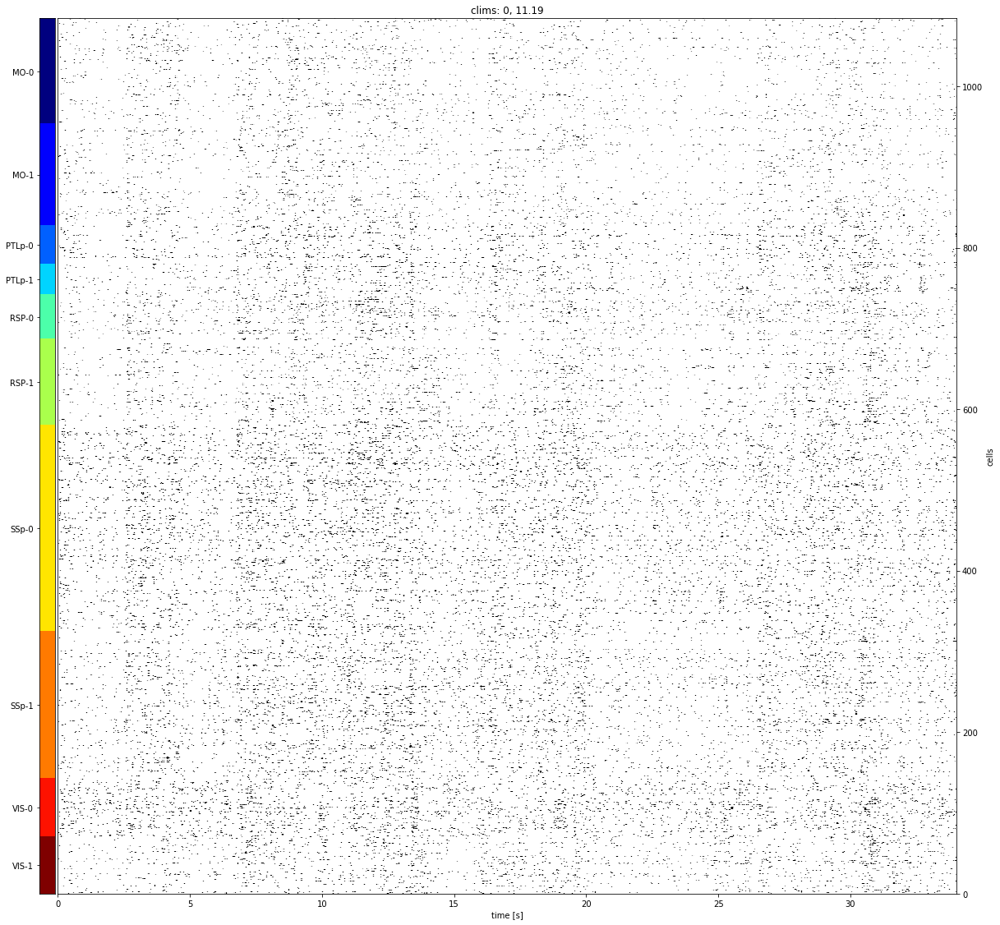

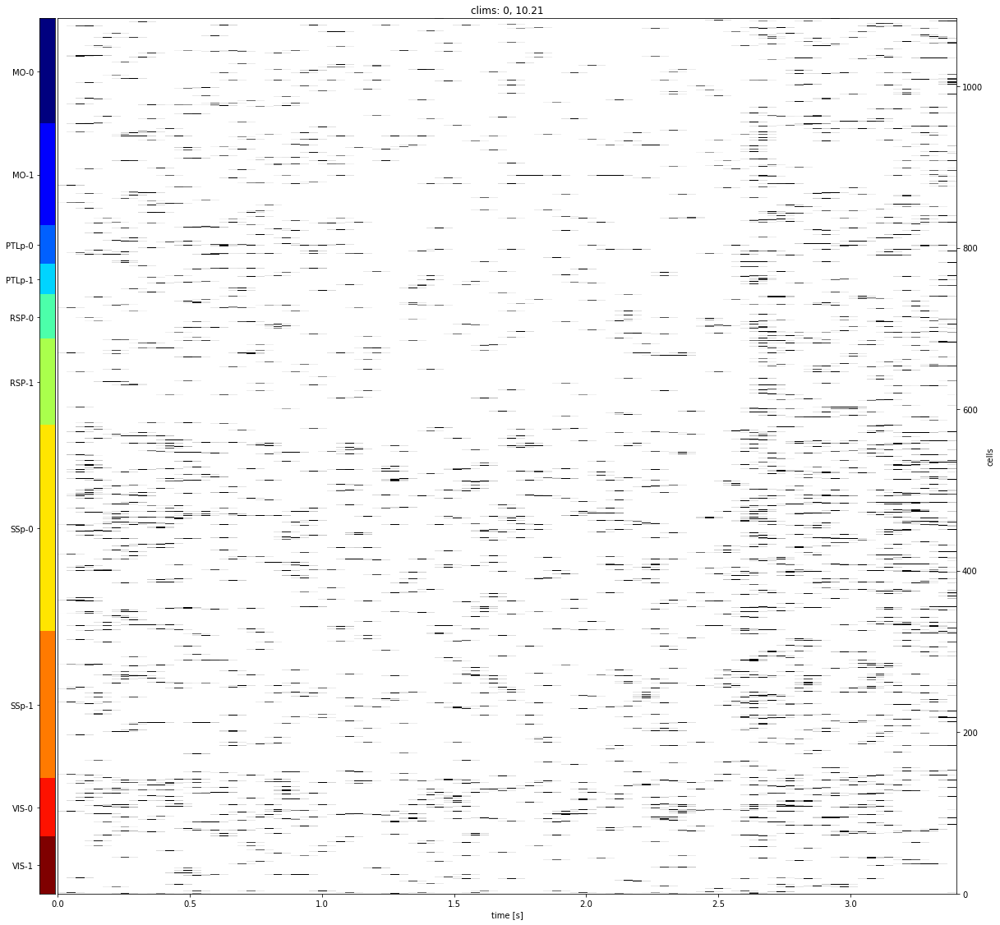

In [48]:
# CT.plot_raster_by_region(traces=gaussian_filter1d(CT.S, 2, axis=1), startframe=0, nframes=20000, event_frames=CT.led_frames)
CT.plot_raster_by_region(traces=gaussian_filter1d(CT.S, 0.5, axis=1), startframe=0, nframes=20000, event_frames=None)
plt.savefig(os.path.join(CT.fig_save_path, 'raster_zoom1.pdf'), transparent=True, rasterized=True, dpi=600)
CT.plot_raster_by_region(traces=gaussian_filter1d(CT.S, 0.5, axis=1), startframe=0, nframes=1000, event_frames=None)
plt.savefig(os.path.join(CT.fig_save_path, 'raster_zoom2.pdf'), transparent=True, rasterized=True, dpi=600)
CT.plot_raster_by_region(traces=gaussian_filter1d(CT.S, 0.5, axis=1), startframe=0, nframes=100, event_frames=None)
plt.savefig(os.path.join(CT.fig_save_path, 'raster_zoom3.pdf'), transparent=True, rasterized=True, dpi=600)


MO
VIS
SSp
PTLp
RSP


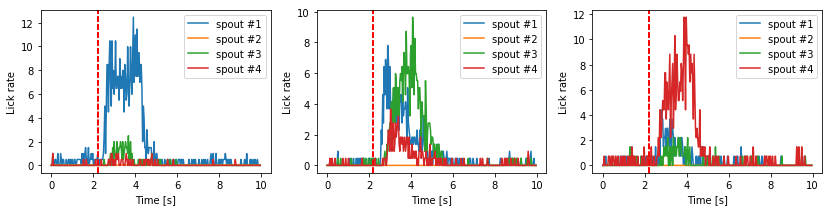

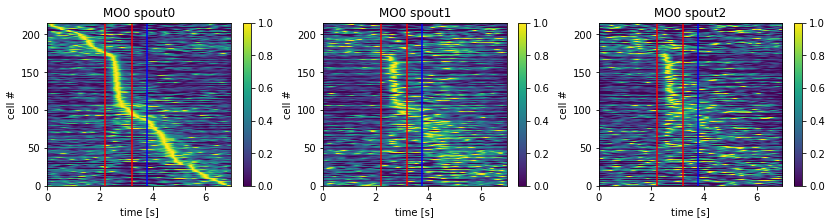

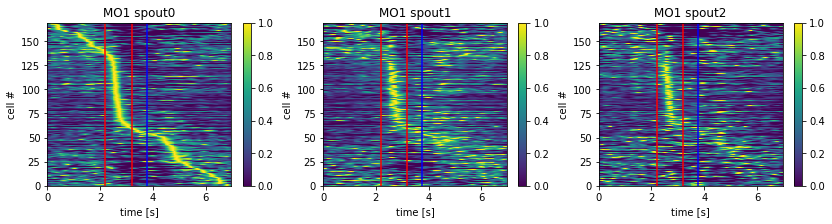

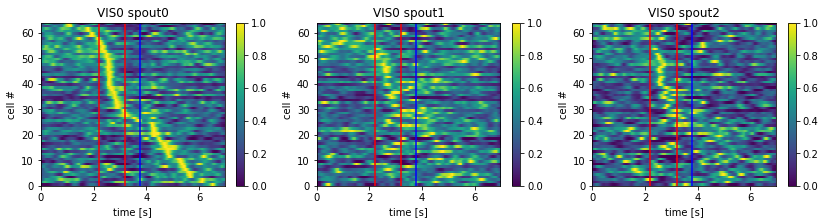

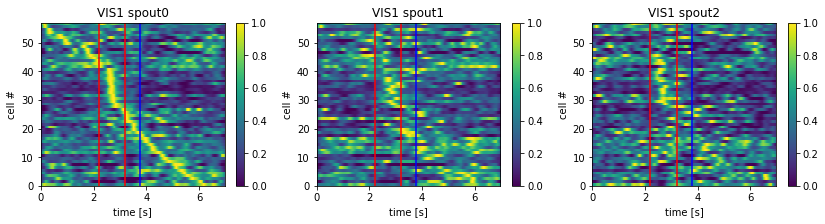

...

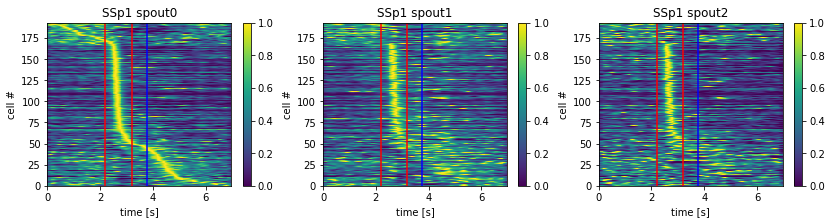

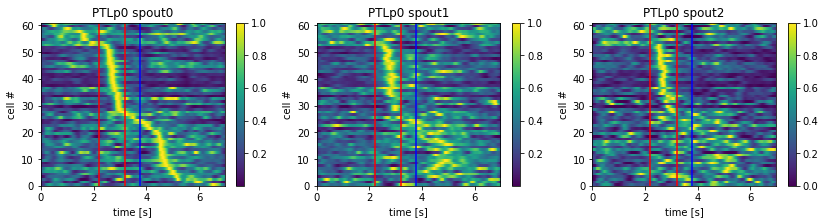

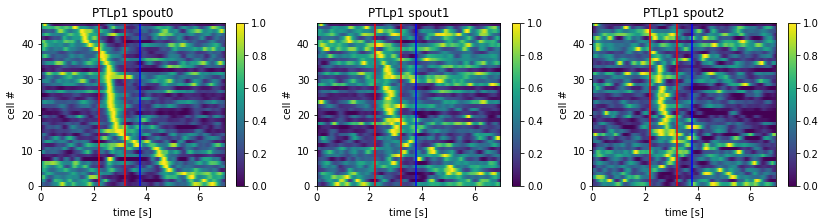

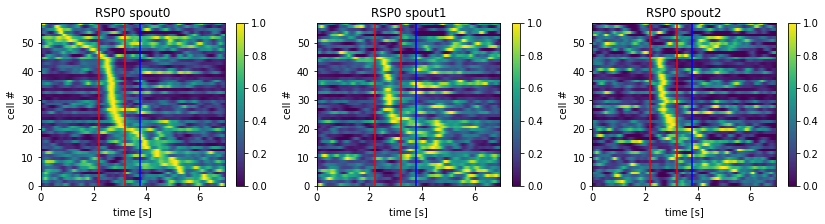

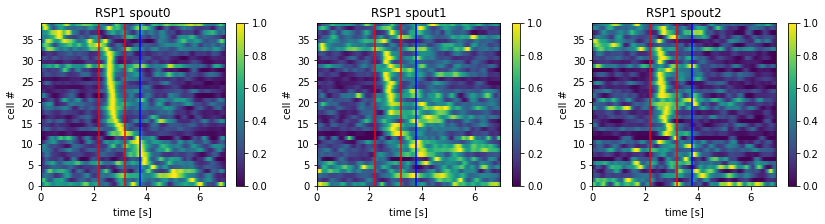

In [10]:
# Plot averaged rasters for each region, across each trial type
# Select cells and regions.
do_save = True


trial_sets = (lick_spout1, lick_spout3, lick_spout4)

plt.figure(figsize=(14,3))
BD.plot_mean_lick_rates(lick_spout1, ax=plt.subplot('131'))
BD.plot_mean_lick_rates(lick_spout3, ax=plt.subplot('132'))
BD.plot_mean_lick_rates(lick_spout4, ax=plt.subplot('133'))

if do_save:
    save_dir = os.path.join(CT.fig_save_path + '/trial_avgs/')
    if not os.path.isdir(save_dir):
        os.makedirs(save_dir)
    plt.savefig(save_dir + 'trial_avg_licks' + '.png' )

# Generate trial averages for specified trials and cells.
for region in ['MO', 'VIS', 'SSp', 'PTLp', 'RSP']:
    print(region)
    for hemisphere in [0, 1]:
        which_cells = np.array(CT.cells_in_region[CT.regions[region]])
        #which_cells = good_cells
        if hemisphere is not None:
            which_cells = which_cells[np.where(CT.hemisphere_of_cell[which_cells]
                                               ==hemisphere)[0]]
        plt.figure(figsize=(14,3))
        for ind, trials in enumerate(trial_sets):
            traces = CT.St_smooth[which_cells,:,:][:,:,np.where(trials[:-1])[0]]
            footprints = CT.footprints[:,:,which_cells]
            trial_means = np.mean(traces, axis=2)
            trial_sems = scipy.stats.sem(traces, axis=2)

            # Make plots.
            if ind == 0:
                ordering1 = utils.plot_average_trial_raster(trial_means, 
                                                        bpod_data=CT.bd, 
                                                        ordering='peak', 
                                                        do_normalize=True, 
                                                        dt = CT.dt,
                                                        ax=plt.subplot('13'+str(ind+1)), 
                                                        title=region+str(hemisphere)
                                                              +' spout'+str(ind))
            else:        
                utils.plot_average_trial_raster(trial_means, 
                                                bpod_data=CT.bd, 
#                                                 ordering='peak', 
                                                ordering=ordering1,
                                                do_normalize=True, 
                                                dt = CT.dt,
                                                ax=plt.subplot('13'+str(ind+1)), 
                                                title=region+str(hemisphere)
                                                      +' spout'+str(ind))
           
        if do_save:
            save_dir = os.path.join(CT.fig_save_path + '/trial_avgs/')
            if not os.path.isdir(save_dir):
                os.makedirs(save_dir)
            plt.savefig(save_dir + 'trial_avg_' + region + str(hemisphere) + '.png' )

In [13]:
# Find trial-type selective cells.

stim_frame = np.round(CT.fps*np.mean(CT.bd.stimulus_times)).astype(int)
reward_frame = np.round(stim_frame + 1.5*CT.fps).astype(int)

# frame_range = [stim_frame-30, stim_frame] # Set this.
frame_range = [stim_frame, stim_frame+60] 
# frame_range = [reward_frame+30, reward_frame+60] 
# frame_range = [stim_frame+30, stim_frame+44] 
do_include_nogo = False

if do_include_nogo:
    trial_sets = (lick_spout1, lick_spout3, lick_spout4, nolick)
else:
    trial_sets = (lick_spout1, lick_spout3, lick_spout4)


selection = utils.get_trial_type_selective_cells(CT.Ct,
                                                 frame_range,
                                                 trial_sets,
                                                 maxpval=1e-3,
                                                 post_hoc='maxdist')
good_cells = selection[0]
range_mean = selection[1]
range_sem = selection[2]
pvals = selection[3]
most_sig = selection[4]
sig_vals = selection[5]

False
---Plotting contours: 1.4854841232299805 seconds ---
False
---Plotting contours: 0.6018686294555664 seconds ---
False
---Plotting contours: 0.5702474117279053 seconds ---


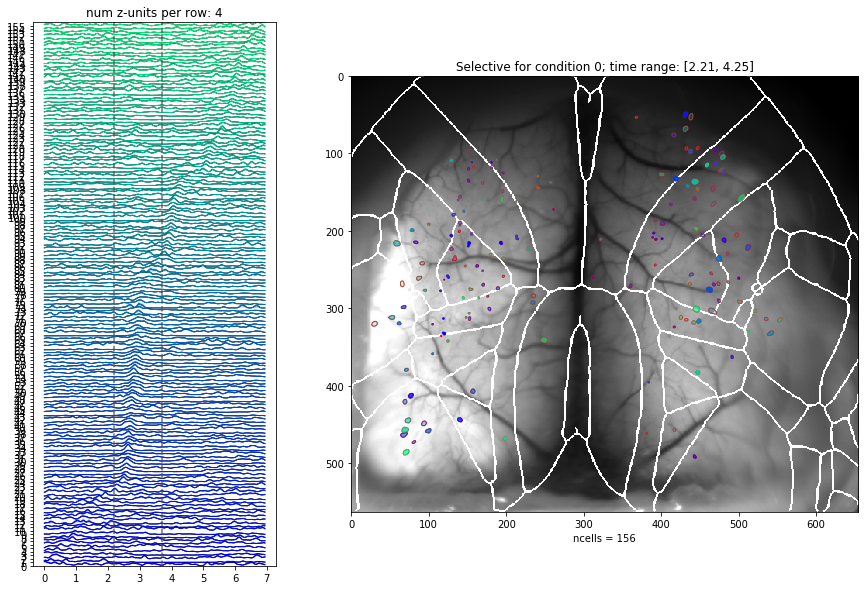

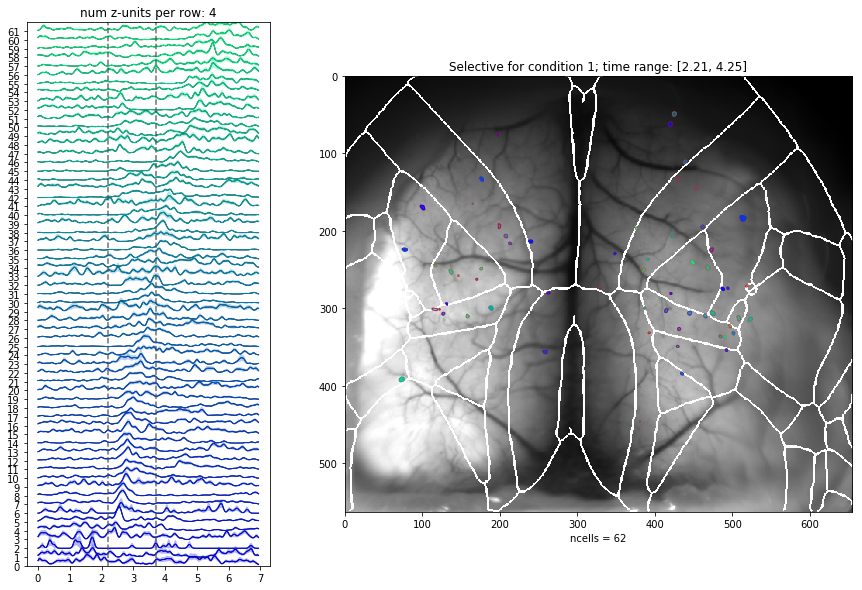

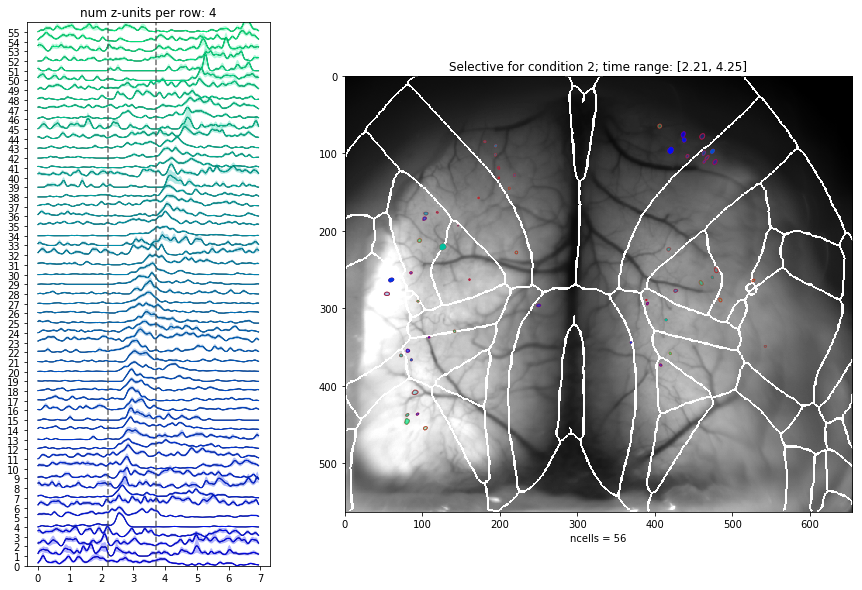

In [14]:
# Plot locations of the trial_selective cells.
# Are there trends in the spatial location of cells discriminative for each condition?
for condition in [0, 1, 2]:
    which_cells = good_cells[np.where(most_sig==condition)[0]]
    which_sig = sig_vals[np.where(most_sig == condition)[0]]
    trials = trial_sets[condition]

    # Generate trial averages for specified trials and cells.
#     traces = CT.Ct[which_cells,:,:][:,:,trials]
    traces = rates[which_cells,:,:][:,:,trials]
    footprints = CT.footprints[:,:,which_cells]
    trial_means = np.mean(traces, axis=2)
    trial_sems = scipy.stats.sem(traces, axis=2)

    alpha = which_sig/np.percentile(which_sig, 95)
    alpha[np.where(alpha>1)[0]] = 1
#     alpha = np.ones(np.shape(alpha))
    title = 'Selective for condition {}; time range: [{:.2f}, {:.2f}]'.format(condition,
                                                                           CT.Tt[frame_range[0]],
                                                                           CT.Tt[frame_range[1]])
    ordering = CT.plot_variance_shaded_traces(trial_means, trial_sems, 
                                              cell_inds=np.arange(0,len(which_cells)),
                                              footprints=footprints,
                                              ordering='peak', 
                                              title=title, 
                                              alpha=alpha) 

---Plotting contours: 0.09779953956604004 seconds ---
---Plotting contours: 0.09955930709838867 seconds ---
---Plotting contours: 0.08580827713012695 seconds ---
---Plotting contours: 0.08589625358581543 seconds ---
---Plotting contours: 0.08359813690185547 seconds ---
---Plotting contours: 0.07886314392089844 seconds ---
---Plotting contours: 0.09957075119018555 seconds ---
---Plotting contours: 0.11023902893066406 seconds ---
---Plotting contours: 0.09469246864318848 seconds ---
---Plotting contours: 0.09556913375854492 seconds ---
---Plotting contours: 0.09831476211547852 seconds ---
---Plotting contours: 0.1134345531463623 seconds ---
---Plotting contours: 0.08803296089172363 seconds ---
---Plotting contours: 0.08425688743591309 seconds ---
---Plotting contours: 0.09150457382202148 seconds ---
---Plotting contours: 0.0786595344543457 seconds ---
---Plotting contours: 0.07982230186462402 seconds ---
---Plotting contours: 0.0781698226928711 seconds ---
---Plotting contours: 0.0887000

/home/izkula/anaconda/envs/cosmos3/lib/python3.5/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  "(`matplotlib.pyplot.figure`) are retained until "


---Plotting contours: 0.11075043678283691 seconds ---
---Plotting contours: 0.08810687065124512 seconds ---
---Plotting contours: 0.09381246566772461 seconds ---
---Plotting contours: 0.08850359916687012 seconds ---
---Plotting contours: 0.08966469764709473 seconds ---
---Plotting contours: 0.09645366668701172 seconds ---
---Plotting contours: 0.07819199562072754 seconds ---
---Plotting contours: 0.08976149559020996 seconds ---
---Plotting contours: 0.09977340698242188 seconds ---
---Plotting contours: 0.07996630668640137 seconds ---
---Plotting contours: 0.07935905456542969 seconds ---
---Plotting contours: 0.07867097854614258 seconds ---
---Plotting contours: 0.07938647270202637 seconds ---
---Plotting contours: 0.08380675315856934 seconds ---
---Plotting contours: 0.07795381546020508 seconds ---
---Plotting contours: 0.08212661743164062 seconds ---
---Plotting contours: 0.07899975776672363 seconds ---
---Plotting contours: 0.07954025268554688 seconds ---
---Plotting contours: 0.1044

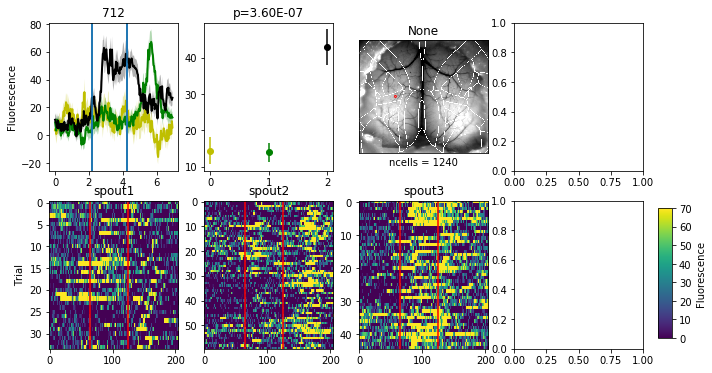

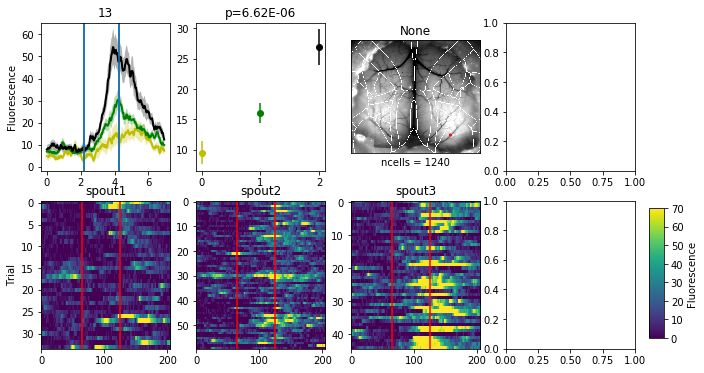

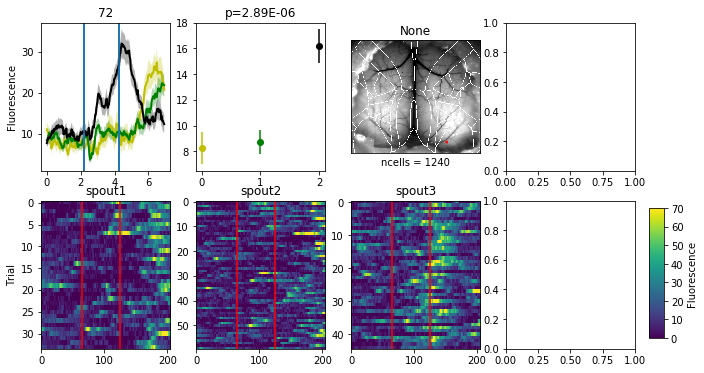

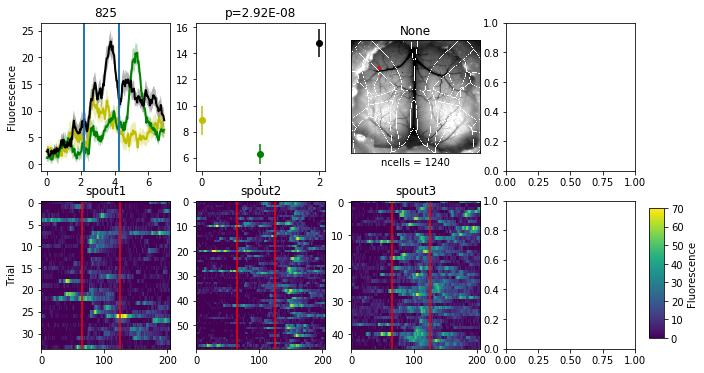

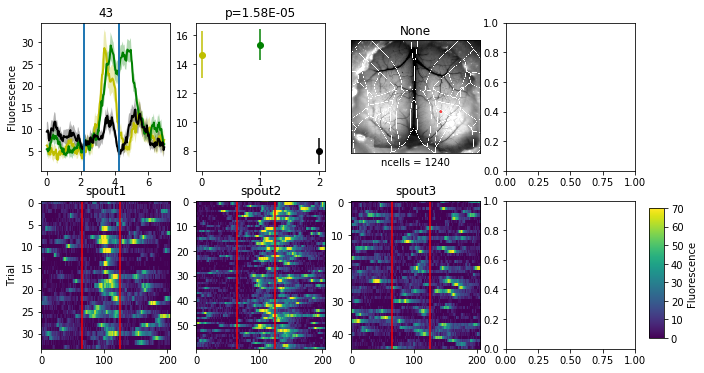

...

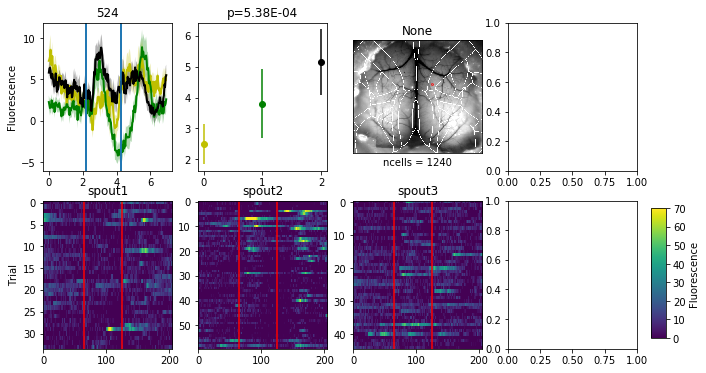

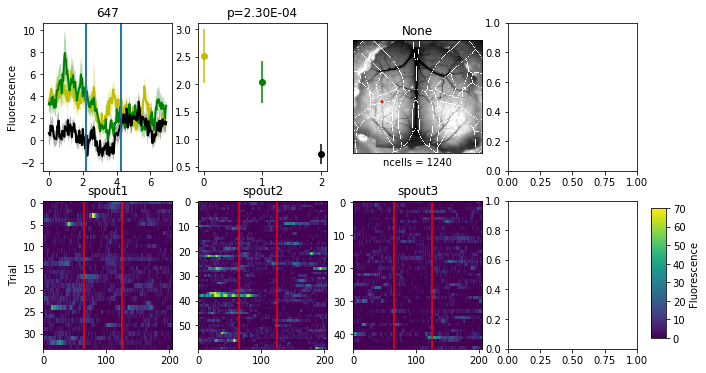

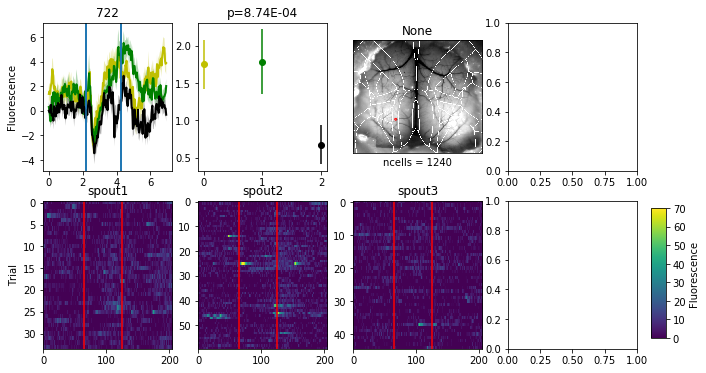

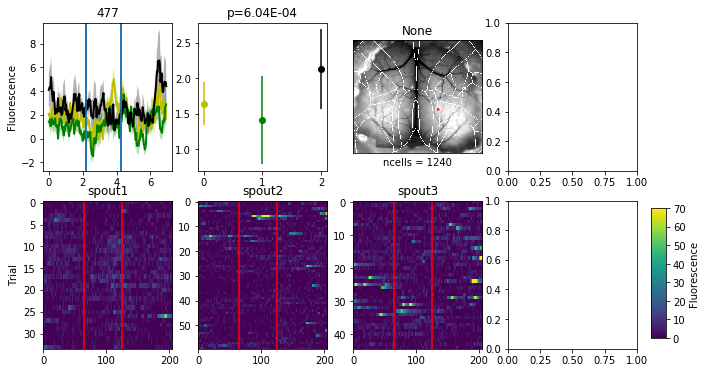

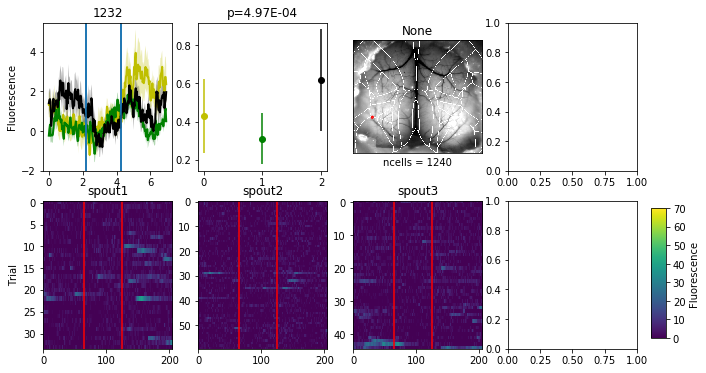

In [57]:
# For each cell, plot overlay of mean response to each of the conditions.

# Define which cells to look at here.
# cells = np.arange(0, 10)
condition = 2 ### Choose the trial type
which_cells = good_cells[np.where(most_sig == condition)[0]]
which_sig = sig_vals[np.where(most_sig == condition)[0]]

ordering = np.argsort(-which_sig)
which_cells = which_cells[ordering]

# which_cells = np.arange(400, 500)

cells = np.array(which_cells[0:100])

if do_include_nogo:
    names = ('spout1', 'spout2', 'spout3', 'nolick')
    colors = ('y', 'g', 'k', 'r')
else:
    names = ('spout1', 'spout2', 'spout3')
    colors = ('y', 'g', 'k')
    
for cell in cells:
    CT.plot_cell_across_trial_types(cell, frame_range, range_mean, range_sem,
                                    trial_sets, names, colors, pvals)

Detected 64 / 193 trials with lick selectivity >=  0.95
0, 100, 0, 100, 0, 100, 0, 100, 0, 100, 

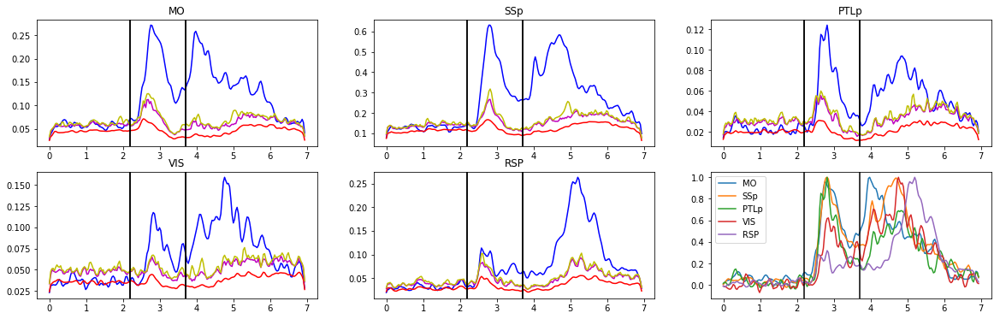

In [41]:
### Population-level neural differences between different lick direction conditions
### Quantify based on Euclidian distance measurement.

clean_trials = np.zeros(BD.success.shape)
clean_trials[BD.get_clean_trials(min_selectivity=0.95)] = 1


diff_r = {}
diff_b_r = {}
plt.figure(figsize=(20,6))
regions = ['MO', 'SSp', 'PTLp', 'VIS', 'RSP']
for ind, region in enumerate(regions):
    which_cells = np.array(CT.cells_in_region[CT.regions[region]])
    # which_cells = which_cells[np.where(CT.hemisphere_of_cell[which_cells]==1)[0]]
    # which_cells = np.arange(np.shape(CT.Ct)[0])

    ### Try different combinations here.
    trials1 = np.where(lick_spout1)[0]
    trials2 = np.where(lick_spout3)[0]
#     trials2 = np.where(nolick)[0]
#     traces = CT.St[which_cells, :,:]
    traces = smooth_spikes[which_cells,:,:]

    ax = plt.subplot(2,3,ind+1)
    plt.title(region)
    event_times = [BD.stimulus_times[0], BD.stimulus_times[0]+1.5]
    out = utils.get_significant_population_difference(traces, 
                                                trials1, 
                                                trials2, 
                                                nbootstrap=101, 
                                                ax=ax,
                                                t=CT.Tt,
                                                event_times=event_times)
    diff_r[region] = out[0]
    diff_b_r[region] = out[1]

# Plot overlay of all regions.
plt.subplot(2,3,6)
for region in regions:
    trace = diff_r[region] - np.mean(diff_b_r[region], axis=0)
    plt.plot(CT.Tt, trace/np.max(trace), label=region)
plt.axvline(BD.stimulus_times[0], color='k')
plt.axvline(BD.stimulus_times[0]+1.5, color='k')
plt.legend()
out={}
out['diff'] = diff_r
out['diff_b'] = diff_b_r

if do_save:
    save_dir = os.path.join(CT.fig_save_path + '/trial_type_differences/')
    if not os.path.isdir(save_dir):
        os.makedirs(save_dir)
    plt.savefig(save_dir + 'euclidean_distances'+ '.png' )

evr: 0.20653588233667614
mine: 0.20653588233667633


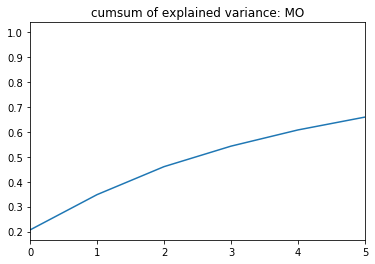

In [14]:
# Testing my explained_variance_ratio function vs. that computed by sklearn PCA.
# This is a utility function you shouldn't need to look at again, but don't delete
# in case you want to double check. 
trial_sets = (lick_spout1, lick_spout3, lick_spout4)

from sklearn.decomposition import PCA
regions = ['MO']
for region in regions:
    plt.figure()
    for hem in [1]:
#         which_cells = np.arange(CT.Ct.shape[0])
        which_cells = np.array(CT.cells_in_region[CT.regions[region]])
#         which_cells = which_cells[np.where(CT.hemisphere_of_cell[which_cells]==hem)[0]]
        traces = CT.Ft[which_cells,:,:]
    
        neuron_means = np.mean(np.mean(traces, axis=2), axis=1)
        traces = traces - neuron_means[:, np.newaxis, np.newaxis]

        tp = utils.average_within_trial_types(traces, trial_sets)
        M = np.hstack((tp[:,:,0], tp[:,:,1], tp[:,:,2]))

        M = M - np.expand_dims(np.mean(M, axis=1), axis=1)
        pca = PCA()
        weights = pca.fit_transform(M.T)
        evr = pca.explained_variance_ratio_
        components = pca.components_
        plt.plot(np.cumsum(evr))
        plt.xlim([0, 5])
    plt.title('cumsum of explained variance: {}'.format(region))
    
# Comparison test here. 
print('evr: ' + str(evr[0]))
print('mine: ' + str(utils.explained_variance_of_basis(M, components[0,:].T)))

0.11078943709762831
[0.08416254 0.02662689]


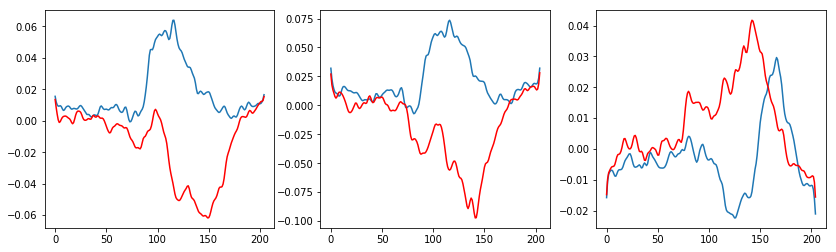

In [17]:
### Visualize cells along coding directions.


### Step 1: Select cells (i.e. from a region)
region = 'MO'
frame_range = [50, 150]
traces = smooth_spikes
# traces = CT.Ft


### NEED TO PREPROCESS? Zscore? Subtract mean across all trials and time?
neuron_means = np.mean(np.mean(traces, axis=2), axis=1)
traces = traces - neuron_means[:, np.newaxis, np.newaxis]

which_cells = np.array(CT.cells_in_region[CT.regions[region]])
# which_cells = np.arange(trace.shape[0])
traces = traces[which_cells,:,:]

basis = utils.get_coding_plane(traces, trial_sets, frame_range, 
                         do_orthogonalize=True, do_plot=True)


# Compute the variance accounted for by this basis.
tp = utils.average_within_trial_types(traces, trial_sets)
tr = np.hstack((tp[:,:,0], tp[:,:,1], tp[:,:,2]))
print(utils.explained_variance_of_basis(tr, basis[:, 0]) + utils.explained_variance_of_basis(tr, basis[:, 1]))
print(utils.explained_variance_of_basis(tr, basis))





### Alternatively, you could find an axis that maximizes the difference - this is LDA?

### Questions to answer about this:
### How much variance do these coding directions actually account for. 
### How stable are they throughout the trajectory?
### How do single trials map onto this?
### How do the coding directions compare between regions? How could you map from one to the other?


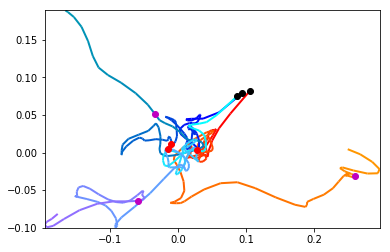

In [18]:
# Plot the trajectories.

event_frames = CT.fps*np.array([0, BD.stimulus_times[0], 
                             BD.stimulus_times[0]+1.5])
traces_to_plot = utils.average_within_trial_types(traces, trial_sets)

b = basis
t0 = np.matmul(traces_to_plot[:,:120,0].T, b)
t1 = np.matmul(traces_to_plot[:,:120,1].T, b)
t2 = np.matmul(traces_to_plot[:,:120,2].T, b)

trajectories = (t0, t1, t2)
cmaps = ('autumn', 'winter', 'cool')
fig2 = plt.figure()
utils.plot_2D_trajectories(trajectories, cmaps, event_frames)

In [79]:
%pdb

Automatic pdb calling has been turned OFF


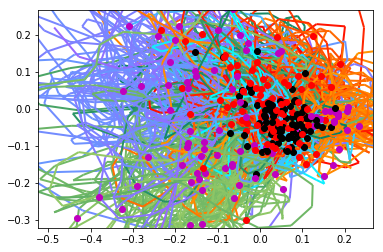

In [103]:
# Plot trajectories of single trials.
start_frame = 0
end_frame = 120
event_frames = CT.fps*np.array([start_frame/CT.fps, BD.stimulus_times[0], 
                             BD.stimulus_times[0]+1.5]) - start_frame


traces_to_plot = utils.average_within_trial_types(traces, trial_sets)

plt.figure()

for single_trial_ind in range(30):
#     plt.figure()
    for i in [0, 1, 2]:
        traces_to_plot[:,:, i] = traces[:,:,np.where(trial_sets[i])[0][single_trial_ind]]

    b = basis
    t0 = np.matmul(traces_to_plot[:,start_frame:end_frame,0].T, b)
    t1 = np.matmul(traces_to_plot[:,start_frame:end_frame,1].T, b)
    t2 = np.matmul(traces_to_plot[:,start_frame:end_frame,2].T, b)

    trajectories = (t0, t1, t2)
    cmaps = ('autumn', 'summer', 'cool')
    utils.plot_2D_trajectories(trajectories, cmaps, event_frames)

## Ideas / TODOs / Inprogress

In [ ]:
### Can you put the different regions in the same basis? 

In [ ]:
### First, we estimated the coding direction (CD) along which preparatory activity maximally discriminated upcoming directional licking

In [ ]:
### Are they different scales in different areas?


In [ ]:
### TODO: PLOT ALL THE CELLS THAT CONSISTENTLY TURN ON IN RESPONSE TO THE ODOR. 
### Do those differ between conditions? In any region?

In [ ]:
### Question we can ask: Is there a different coding direction for 
### licking in the forward direction as opposed to each of the sides? 
### This seems like it could be a fruitful direction. Can you determine
### the shape of this?

In [ ]:
## Are PCs similar across days. How do PCs compare between regions. 
## TODO

In [ ]:
#### k-means on full trace, or on different segments of the trace, are there neurons that are shared. 
### cluster on the full trace? and then average? that is too high dimensional.

In [ ]:
## Look at explore vs. exploit trials. 

In [ ]:
### Compute neural information across time (i.e. from earl miller paper 2015)
### TODO

In [54]:
### Finding mutual information at each time point. From Akrami et al. 

### They compute the percentage of cells in a region that contain mutual information about the current trial type
### and the previous trial type. 

### This is how you would test whether there is any information about the previous trial type (but your hopes
### should not be high - since you weren't seeing any discriminating cells?)


### We need:
### - P(x) - the probability of task parameter x: Lick direction (3 possibilities) on current or prev trial. 
####          in their case, the x's are a specific stimulus pair (they treat each pair as a single stimulus).
### - P(r|x) - the conditional probability of observing a neuronal response given the presentation of task param x.
###            this is the same as P(r, x)/P(x)
### - P(r) - the marginal probability of occurence of neuronal response r (i.e. the firing rate r) among all possible responses
###          (compute this from histogram of distribution of firing rates?)
### - P(r, x) - the probability of task parameter x and neuronal response r. 
### This tells you how well an ideal observer could discriminate between the stimuli x, on the basis of the neuronal 
### responses of a single trial (is this similar to the ROC analysis?)
### Neural response r is the rate of spiking during a 100ms time window. 
### The mutual intensity at each time point is a single value, because you sum across x. 

### Then - to correct for an upward bias in estimate of MI. 
### 1) Use the quadratic extrapolation method to approximate the bias.
### 2) Shuffling. Pair stimuli and responses at random. Information may still be positive. Average value of this
###    bootstrapped information (at each time point), is then subtracted out. Can also use this to compute
###    whether the information (that has already been corrected using quadratic extrapolation) is significantly
###    different from zero. 


### Outcomes of this analysis:
### - 1) Map of cells that significantly discriminate? 

trial_sets = (np.logical_and.reduce((BD.go_trials.astype('bool'), 
                                     BD.success, 
                                     BD.spout_positions==1))[:-1],
             np.logical_and.reduce((BD.go_trials.astype('bool'), 
                                     BD.success, 
                                     BD.spout_positions==3))[:-1],
             np.logical_and.reduce((BD.go_trials.astype('bool'), 
                                     BD.success, 
                                     BD.spout_positions==4))[:-1])
s = smooth_spikes

ncells = s.shape[0]
nt = s.shape[1]
nbins = 10
bins = np.linspace(0, 1, nbins)

Prx_unnorm = np.zeros((ncells, nbins-1, len(trial_sets), nt)) #Joint probability distribution

ntrials = 0
for trial_set in trial_sets:
    print(np.where(trial_set)[0])
    ntrials = ntrials + len(np.where(trial_set)[0])    
    
for ii, trial_set in enumerate(trial_sets):
    print(ii)
    trials = np.where(trial_set)[0]    
    for cell in range(ncells):
        for t in range(nt):
            Prx_unnorm[cell, :, ii, t] = np.histogram(s[cell, t, trials], bins=bins)[0]
            
### Compute mutual information
Prx = (Prx_unnorm+0.00000000001)
Prx = Prx/np.sum(Prx)
Pr = np.sum(Prx, axis=2)
Px = np.sum(Prx, axis=1)
Prgivenx = Prx/Px[:,np.newaxis,:,:]

MI = np.sum(Px*np.sum(Prx*np.log2(Prgivenx/Pr[:,:,np.newaxis,:]), axis=1), axis=1)

### TODO: Quadratic extrapolation to estimate bias. 
###       Factor into function. Compute bootstrap shuffled MI (specifically, shuffle )

# Plot mutual intensity results
plt.figure(figsize=(15, 15))
plt.imshow(MI, aspect='auto')
plt.colorbar()

plt.plot(np.abs(np.sum(MI, axis=0)))
event_frames = CT.fps*np.array([0, BD.stimulus_times[0], 
                             BD.stimulus_times[0]+1.5])
plt.axvline(event_frames[0])
plt.axvline(event_frames[1])
plt.axvline(event_frames[2])

[  0   1   2   4   6   7   8   9  12  13  14  16  87  88  89  90  91  92
  94  95  96  97 100 101 103 104 105 106 142 143 144 145 146 147 153 155
 173 174 175 176 177 178 179 180 182 183 184 185 186 189 190 191]
[ 17  18  19  20  22  23  24  26  27  29  31  33  34  35  36  54  55  56
  57  58  60  61  62  63  65  66  67  68  69  70 122 123 124 125 126 127
 129 130 131 132 134 136 137 138 139 140 141 157 158 159 160 161 162 163
 164 165 166 167 168 169 171 172]
[ 37  38  39  42  44  45  47  48  49  50  51  52  53  72  73  74  77  78
  80  81  82  84  85  86 107 108 109 110 111 112 113 114 115 116 117 118
 119 120 121 192 193 194 195 196 197 198 199 200 201 202 204 205 206 207
 208 209]


# LESS ORGANIZED CODE BELOW

Begin correlation investigation

In [ ]:
## Look at lagged correlations
## TODO

In [15]:
## Generate seeded correlation plots (from each neuron)
c, p = scipy.stats.spearmanr(rates_flat, axis=1)

# TODO: update this to use pycorrelate instead??

In [16]:
## Compute relationship between correlation and distance

nneurons = c.shape[0]
cdists = np.zeros((nneurons,1))
pdists = np.zeros((nneurons, 1))
n_high_corr = np.zeros((nneurons, 1))
high_corr_neurons = {}

high_corr_thresh = 0.15

for neuron in range(nneurons):
    corrs = np.copy(c[neuron, :])
    pvals = np.copy(p[neuron, :])
    dists = np.copy(distances[neuron, :])
    
    pthresh = 1e-3
    not_sig = pvals > (pthresh/len(corrs)/len(corrs))
    sig = pvals < (pthresh/len(corrs)/len(corrs))
    sig[neuron] = 0
    cdist, pdist = scipy.stats.spearmanr(dists[sig], abs(corrs[sig]))
    cdists[neuron] = cdist
    pdists[neuron] = pdist
    
    high_corr_neurons[neuron] = np.where(np.logical_and(corrs>high_corr_thresh, sig))[0]
    n_high_corr[neuron] = len(high_corr_neurons[neuron])
    

In [17]:
# global_neurons = np.where(np.logical_and(n_high_corr>5, pdists>0.01/nneurons**2))[0]
# local_neurons = np.where(np.logical_and(n_high_corr>5, pdists<0.01/nneurons**2))[0]
global_neurons = np.where(np.logical_and(n_high_corr>5, pdists>1e-2))[0]
local_neurons = np.where(np.logical_and(n_high_corr>5, pdists<1e-8))[0]

In [18]:
### How would you cluster?

/home/izkula/anaconda/envs/cosmos3/lib/python3.5/site-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


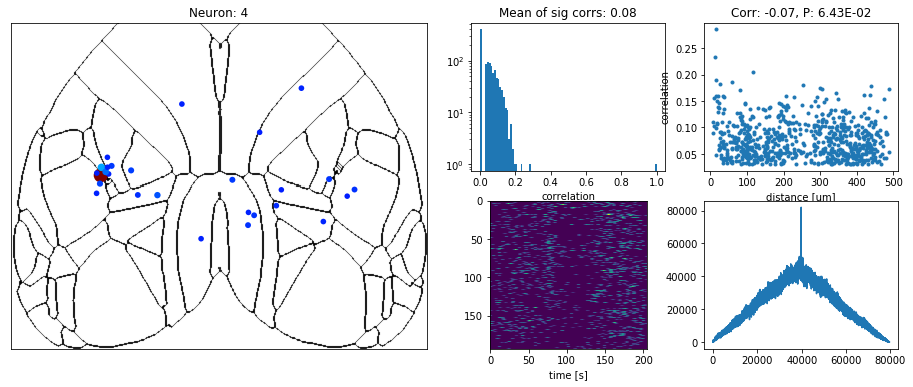

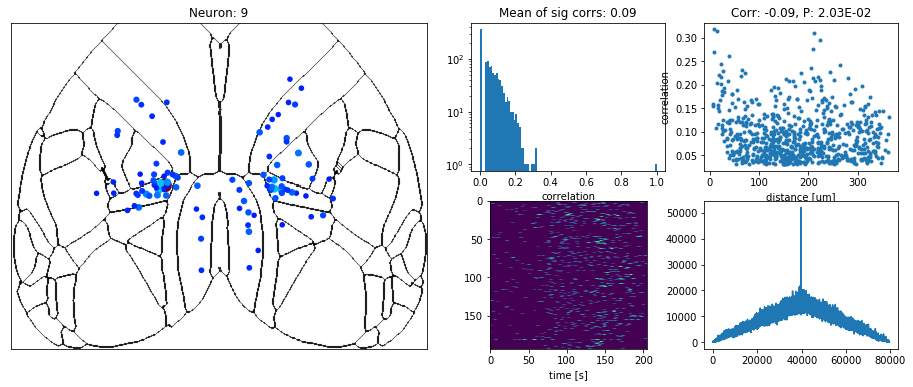

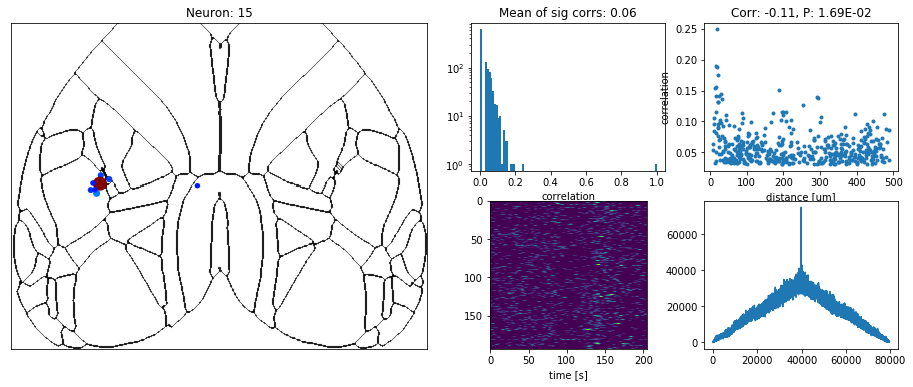

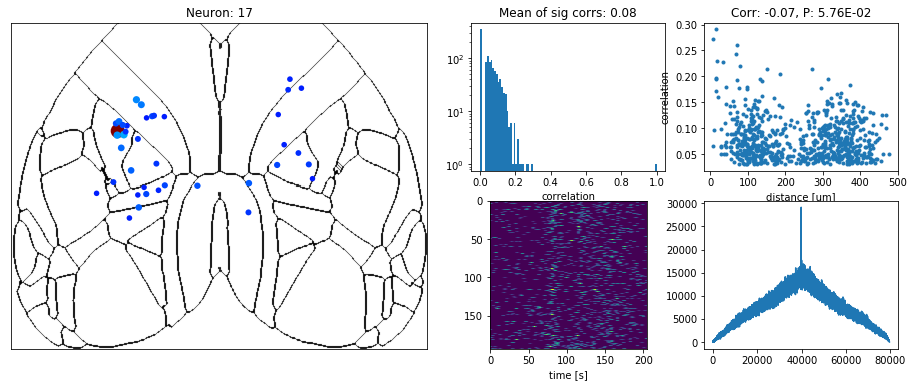

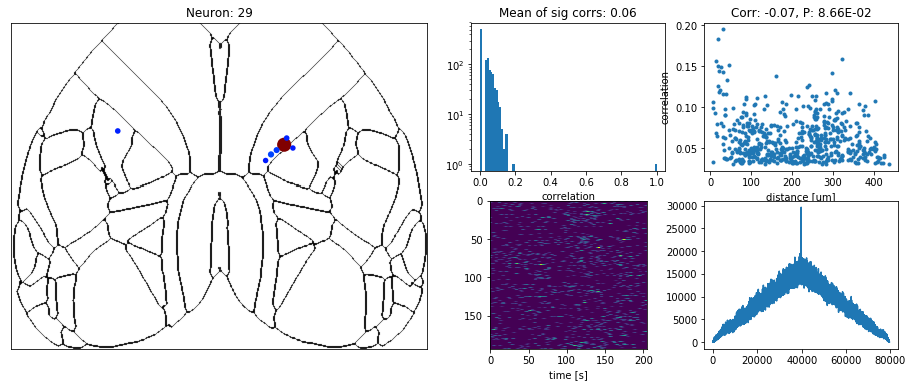

...

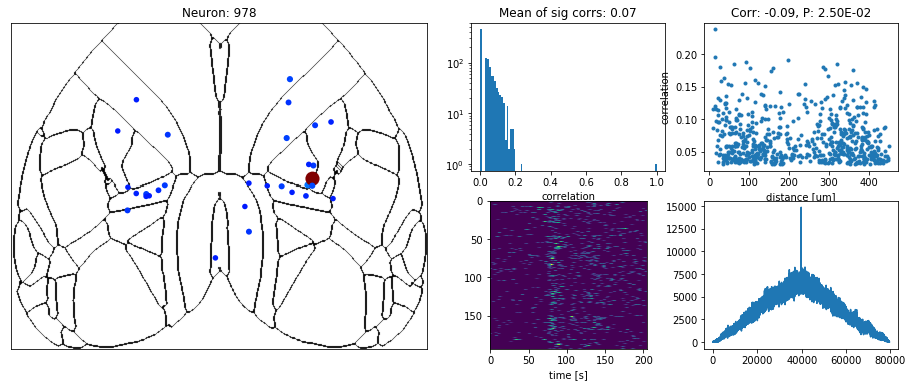

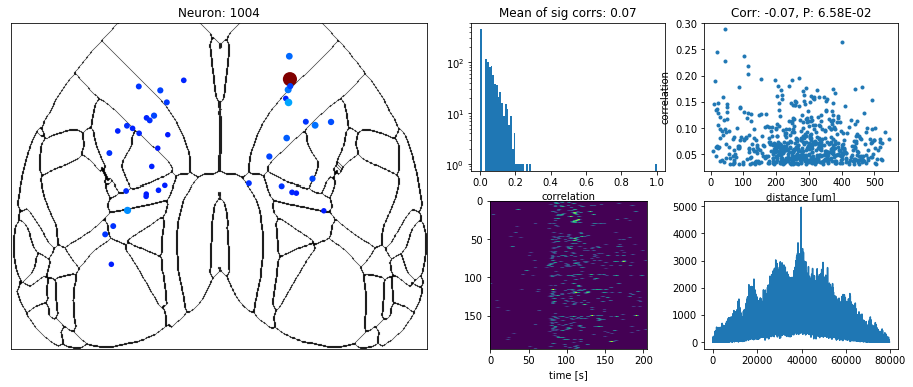

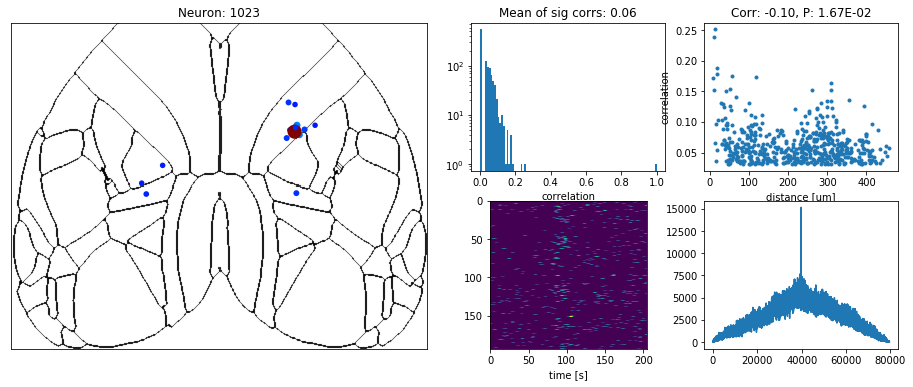

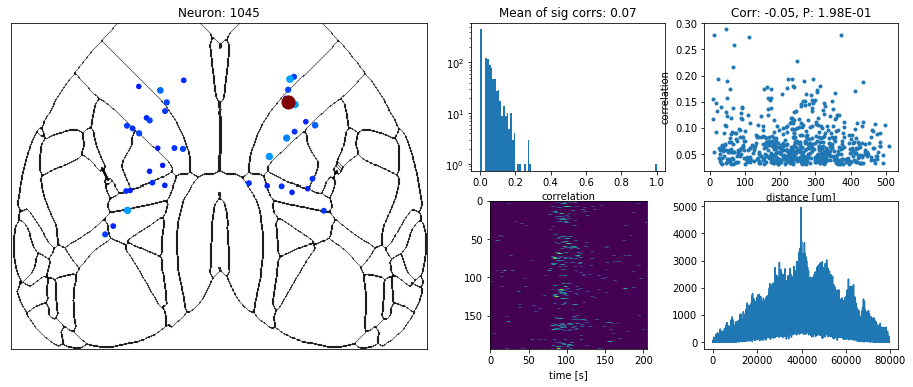

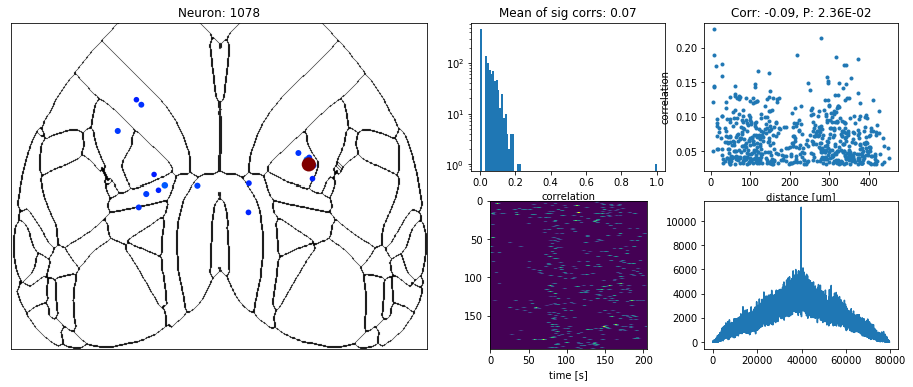

In [19]:
## Now plot seeded correlations
# for neuron in range(0, 10):
for neuron in global_neurons:
    fig = plt.figure(figsize=(16, 6))
    gs = []
    gs.append(plt.subplot2grid((2, 4), (0, 0), colspan=2, rowspan=2))
    gs.append(plt.subplot2grid((2, 4), (0, 2), colspan=1))
    gs.append(plt.subplot2grid((2, 4), (0, 3), colspan=1))
    gs.append(plt.subplot2grid((2, 4), (1, 2), colspan=1))
    gs.append(plt.subplot2grid((2, 4), (1, 3), colspan=1))
    
    
    
    corrs = np.copy(c[neuron, :])
    pvals = np.copy(p[neuron, :])
    dists = np.copy(distances[neuron, :])
    pthresh = 1e-3
    not_sig = pvals > (pthresh/len(corrs)/len(corrs))
    sig = pvals < (pthresh/len(corrs)/len(corrs))
    sig[neuron] = 0
    corrs[not_sig] = 0
    corrs_thresh = np.copy(corrs)
    corrs_thresh[np.where(corrs_thresh<0.15)] = 0
#     plt.figure(figsize=(16,8))
    
#     plt.subplot(1,2,1)
    plt.subplot(gs[0])
#     CT.centroids_on_atlas(corrs, np.arange(len(corrs)), max_radius=200)
    CT.centroids_on_atlas(corrs_thresh, np.arange(len(corrs_thresh)), max_radius=200)
    plt.title('Neuron: {}'.format(neuron))
    
#     plt.subplot(1,6,4)
    plt.subplot(gs[1])
    plt.hist(abs(corrs), bins=100)
    plt.title('Mean of sig corrs: {:.2f}'.format(np.mean(abs(corrs[sig]))))
    plt.yscale('log', nonposy='clip')
    plt.xlabel('counts')
    plt.xlabel('correlation')
    
#     plt.subplot(1,6,5)
    plt.subplot(gs[2])
    plt.plot(dists[sig], abs(corrs[sig]), '.')
    plt.xlabel('distance [um]')
    plt.ylabel('correlation')
    cdist, pdist = scipy.stats.spearmanr(dists[sig], abs(corrs[sig]))
    plt.title('Corr: {:.2f}, P: {:.2E}'.format(cdist, pdist))
    
#     plt.subplot(1,6,6)
    plt.subplot(gs[3])
    plt.imshow(rates[neuron,:,:].T)
    plt.xlabel('time [s]')
    
    plt.subplot(gs[4])
    corrs[np.argmax(corrs)] = 0
    most_corr_neuron = np.argmax(corrs)
    cross_corr = scipy.signal.correlate(rates_flat[neuron,:], rates_flat[most_corr_neuron,:])
    plt.plot(cross_corr)
#     plt.imshow(rates[most_corr_neuron,:,:].T)



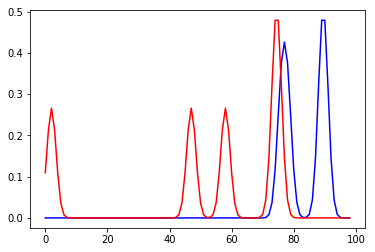

In [35]:
plt.plot(rates_flat[7,1:100], 'b')
plt.plot(rates_flat[20,1:100], 'r')

In [50]:
## See how often the neurons are on simultaneously (this is different than the correlation?)
fractions = []
corrs = []
for neuron in range(nneurons):
    together = np.sum(np.array(rates_flat[7,:]>0)*np.array(rates_flat[neuron,:]>0))
    separate = np.sum(np.array(rates_flat[7,:]>0)) + np.sum(np.array(rates_flat[neuron,:]>0))
    fraction = together/separate
    cc, pp = scipy.stats.pearsonr(rates_flat[7,:], rates_flat[neuron,:])
    fractions.append(fraction)
    corrs.append(cc)

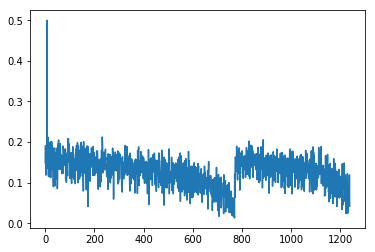

In [49]:
## Seems like this just pulls out an artifact of the SNR/spike deconvolution
plt.plot(np.array(fractions))

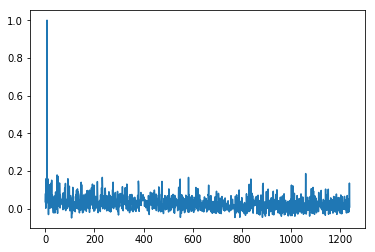

In [51]:
plt.plot(np.array(corrs))

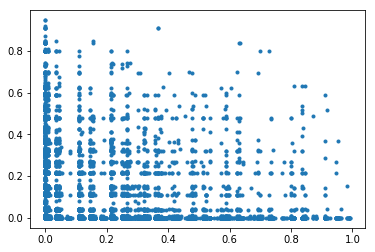

In [36]:
plt.plot(rates_flat[6,:], rates_flat[7,:], '.')

In [27]:
rates_flat[[7,21],:].shape

(2, 43255)

In [46]:
scipy.stats.spearmanr(rates_flat[[7,20],:], axis=1)

SpearmanrResult(correlation=0.19155144900457383, pvalue=0.0)

In [29]:
scipy.stats.pearsonr(rates_flat[7,:], rates_flat[20,:])

(0.1279830232572406, 2.2918038482222963e-157)

In [90]:
incl_neurons

array([  0,   9,  21,  24,  40,  47,  52,  55,  77,  83,  96, 105, 124,
       125, 149, 150, 167, 173, 178, 194, 225, 234, 251, 327, 332, 336,
       337, 345])

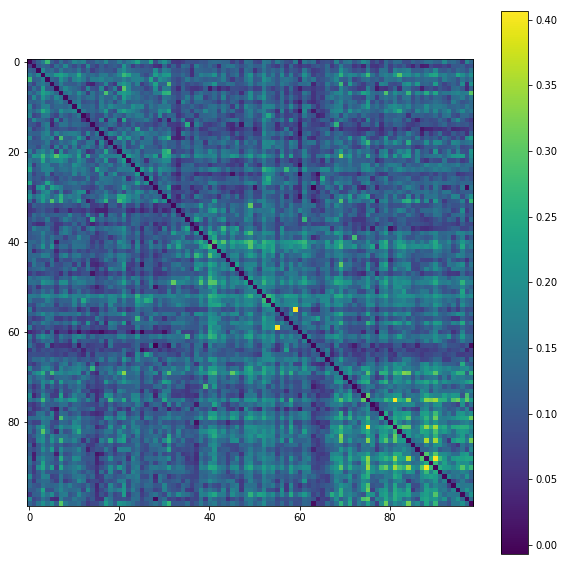

In [19]:
### Look at correlation matrix of neurons that are highly correlated with a specified neuron
neuron = 7

incl_neurons = high_corr_neurons[neuron]
incl_neurons = np.append(incl_neurons, neuron)
cn, pn = scipy.stats.spearmanr(rates_flat[incl_neurons,:], axis=1)
np.fill_diagonal(cn, 0)


data = cn

do_cluster = True

if do_cluster:
    model = SpectralCoclustering(n_clusters=3, random_state=0)
    model.fit(data)
    fit_data = data[np.argsort(model.row_labels_)]
    fit_data = fit_data[:, np.argsort(model.column_labels_)]

    # db = DBSCAN(eps=0.3, min_samples=10).fit(data)
    # core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
    # core_samples_mask[db.core_sample_indices_] = True
    # labels = db.labels_
    # fit_data = data[np.argsort(db.labels_)]
    # fit_data = fit_data[:, np.argsort(db.labels_)]


    # np.fill_diagonal(fit_data, 0)
    plt.figure(figsize=(10,10))
    plt.imshow(fit_data)
    plt.colorbar()
else:
    plt.imshow(data)
    plt.colorbar()

In [14]:
### TODO TODO: CLUSTER BASED ON RELATIONSHIP BETWEEN DISTANCE AND CORRELATION.
### LOOK AT THE TRACES OF THOSE NEURONS. DO THEY JUST CORRESPOND TO MOVEMENT?

In [229]:
pca.components_.shape

(100, 1240)

In [232]:
rates_flat.shape

(1240, 43255)

End correlation investigation

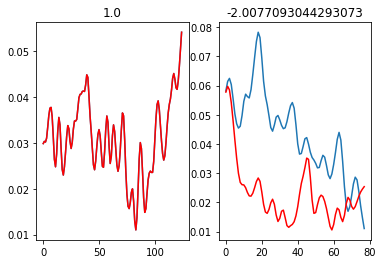

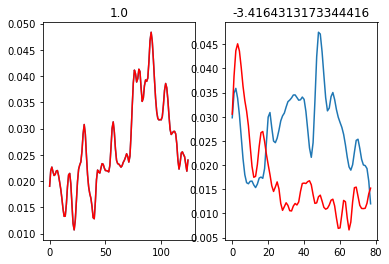

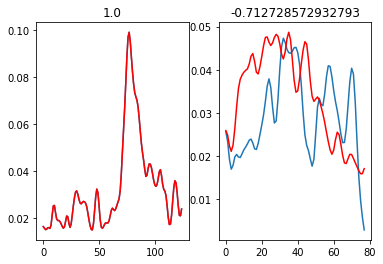

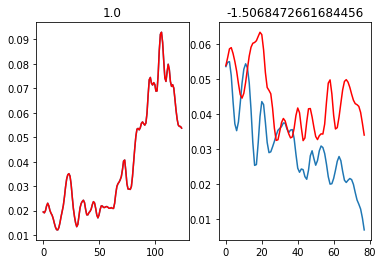

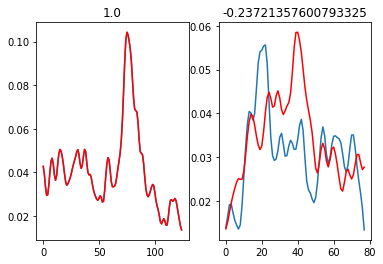

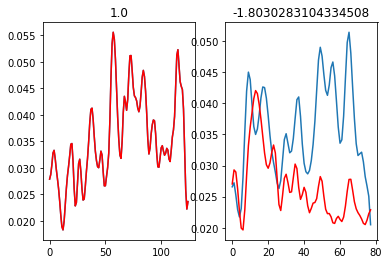

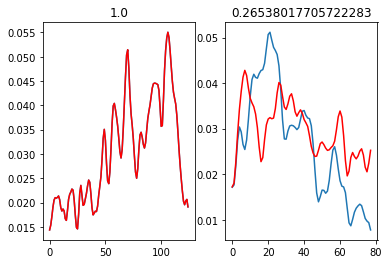

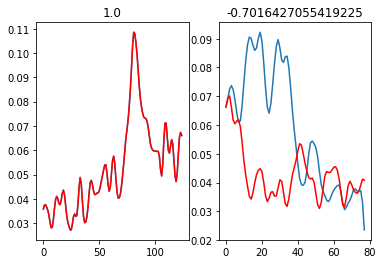

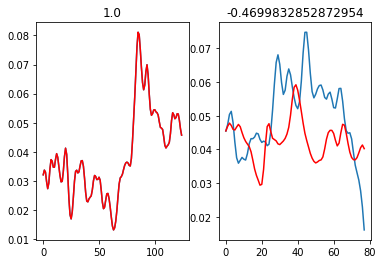

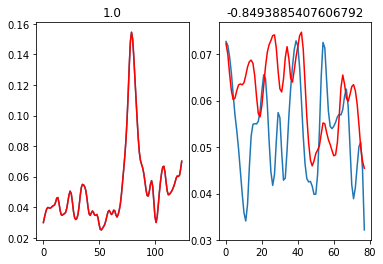

In [45]:
### Can you fit a linear model that predicts neural activity from other neural activity?
### Start with trial averaged traces.
import sklearn.linear_model

flat_smooth_spikes = gaussian_filter1d(CT.S, axis=1, sigma=1.5)
smooth_spikes = gaussian_filter1d(CT.St, 1.5, axis=1, mode='constant')

input_region = 'VIS'
output_region = 'VIS'
traces = np.mean(smooth_spikes, axis=2)
test_ind = 125
# traces = flat_smooth_spikes
# test_ind = 30000

### Should this be preprocessed?

input_cells = np.array(CT.cells_in_region[CT.regions[input_region]])
output_cells = np.array(CT.cells_in_region[CT.regions[output_region]])

output_cells = output_cells[:10]
A = np.zeros((len(input_cells), len(output_cells)))
time_shift = 2
for ind, cell in enumerate(output_cells):
        # Generate data matrices.
        y = traces[cell,time_shift:].T
        data_cells = input_cells
        data_cells = np.delete(data_cells, np.where(data_cells==cell)[0])
        X = traces[data_cells,:-time_shift].T ### Can you predict this cell from other cell's current state
        
        LR = sklearn.linear_model.LinearRegression()
        trainX = X[:test_ind, :]
        trainY = y[:test_ind]
        testX = X[test_ind:, :]
        testY = y[test_ind:]
        LR.fit(trainX, trainY)
        score_train = LR.score(trainX, trainY)
        score_test = LR.score(testX, testY)
        # Linear regression
        plt.figure()
        plt.subplot('121')
#         plt.plot(y[test_ind:])
#         plt.plot(LR.predict(X[test_ind:, :]), 'r')
        plt.plot(trainY)
        plt.plot(LR.predict(trainX), 'r')
#         plt.xlim([0, 1000])
        plt.title(str(score_train))
        plt.subplot('122')
        plt.plot(testY)
        plt.plot(LR.predict(testX), 'r')
#         plt.xlim([0,1000])
        plt.title(str(score_test))




In [7]:
p = LR.get_params()

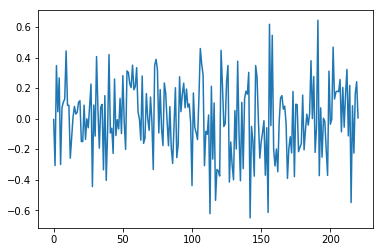

In [11]:
plt.plot(LR.coef_)

In [ ]:
"""
https://web.stanford.edu/~shenoy/GroupPublications/SeeleyEtAlPLoSCompBio2016.pdf
We analyzed nine physiological datasets: three recorded from V1 during presentation of visual stimuli, four recorded from M1 during reaching tasks, and two recorded from muscle populations during the same reaching tasks. Each dataset employed multiple conditions: different stimuli/reaches. Each neuron’s response was averaged across trials within a condition and smoothed to produce a firing rate as a function of time. Some recordings were simultaneous and some were sequential, but in all cases the same set of conditions was employed for every neuron. Stimuli were never tailored to individual neurons (e.g., to their preferred direction or receptive field). This allows for analysis of the true population response, indexed by neuron, condition, and time.
THIS ANALYSIS IS PRETTY EASY: YOU CREATE A 2D ARRAY THAT EITHER STACKS ALONG NEURONS OR CONDITIONS. I.e. you either make an R^{N X CT} or an R^{C * NT} matrix. And then run SVD and pick the top k right singular vectors  which can be resahped into bases matrices. 
### NEED TO COMPARE THIS IN DIFFERENT AREAS
### Use spiking?
### Then try this on the visual data, but only for three conditions? But we might want displayed images. 
### Spike filter width, varies from 10 ms to 100ms did not cause an issue either? Using the deconvolved spikes should work...?

### Note: 'neuron_preferred' represents models driven by input x(t, c) = Bu(t, c)
          'condition-preferred' represents model x(t+1, c) = Ax(t, c)
### For a dynamics model - the matrix A and initial state fully determine the firing rate. 
     A defines a set of population-level patterns from which the response can be built via linear combination.
     This is different from what PCA is telling you? Yes, this is almost stricter? 
     How do the neurons combine to yield the next state. 
     
Summary - if neurons are primarily driven by input (a purely tuning model), 
          then you can group them across time.
However, if neurons follow a dynamics matrix, then the neurons themselves may not group
across time, but they evolve following a basis set of vectors (define by A).

Potentially you could see v1 still be tuned, but not it is just tuned to top-down inputs?

Do we record enough neurons to see the dynamics? Potentially not...
"""


In [1]:
regions = ['MO', 'SSp', 'PTLp', 'VIS', 'RSP']
for ind, region in enumerate(regions):
    which_cells = np.array(CT.cells_in_region[CT.regions[region]])
#     trials = np.where(lick_spout1)[0]
    traces = smooth_spikes[which_cells,:,:]
    trials = np.arange(smooth_spikes.shape[2])
    traces = traces[:,:, trials]
    
    ### Step 0: Smooth spike trains with 20ms stdev gaussian kernel, sampled every 10ms
    
    ### Step 0.1: Average firing rates across trials to yield tensor of size N x C x T
    
    ### Step 0.2: Soft-normalization of firing rates. See eqn 8. 
    
    ### Step 0.3: Remove cross-condition mean. Average tensor across conditions to yield
    ### NxT matrix that you subtract across C axis. This removes response structure that is
    ### identical across conditions. 
    
    ### Step 0.4: Remove neurons so that N = C???? wtf. I guess try without doing this.
    ### This doesn't really make sense anymore though...
    
    ### Step 1: 

### Compute mean across trials for each cell
trial_mean = np.expand_dims(np.mean(traces, axis=2), axis=2)

NameError: name 'np' is not defined

In [ ]:
### Fit a dynamics model???

In [ ]:
### Are there a set of models we are comparing?
### Top-down control, vs. local dynamics, vs. global dynamics, vs. input/movement

In [ ]:
### We need more mice. Start training new ones? 

In [34]:
# Noise correlation: Find correlation after subtracting off the mean trace. 

trials = np.where(lick_spout1)[0]
traces = smooth_spikes[which_cells,:,:]
traces = traces[:,:, trials]

### Compute mean across trials for each cell
trial_mean = np.expand_dims(np.mean(traces, axis=2), axis=2)

mean_sub = traces - trial_mean


### For each cell, for a trial type, subtract the mean across trials
### Correlate the residual
### Or do you want to subtract the mean across cells? 
### Are there multiple clusters? 


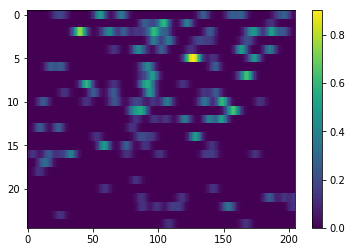

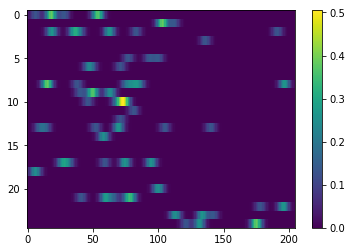

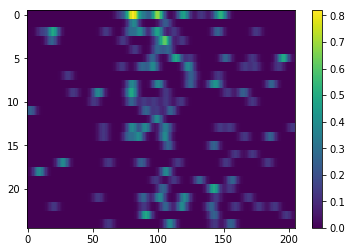

In [43]:
plt.imshow(traces[1,:,:].T, aspect='auto')
plt.colorbar()
plt.figure()
plt.imshow(traces[2,:,:].T, aspect='auto')
plt.colorbar()
plt.figure()
plt.imshow(traces[3,:,:].T, aspect='auto')
plt.colorbar()


## Cross correlation between all cells and all trials?

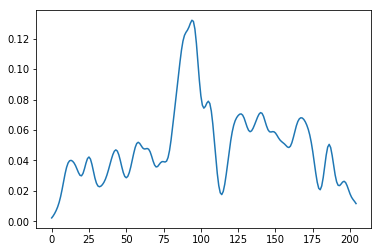

In [39]:
plt.plot(trial_mean[1,:])

In [ ]:
### 1) Are there heterogeneous responses between cells
### 2) To what extent can they just be described by motor output or sensory stimuli
### 3) 



In [ ]:
### 1) Does the dynamical mode of i.e. visual cortex change during the task vs. during visual stim?

In [ ]:
###The attention axis was defined by the mean response of each neuron in each attention condition. 
### Notably, the authors found that the projection onto the attention axis predicted behavioral performance
### on a trial-by-trial basis (Fig. 3a), an effect that was not possible to see at the level of individual neurons. 
### The key to this finding was the projection, which leveraged statistical power across the entire recorded population to estimate an underlying attentional state on a single-trial basis.

### Which axis should we project onto? The direction axis --- Could define it as the average
### activity of each cell in response to left or right lick.
### With three spouts, this could be a plane - unless it is colinear.
### What if you project the third spout onto the plane made by the other two spouts?

In [ ]:
### Latent dynamical system?

### Need to use cross-validation to choose dimensionality?
### Need test dataset (this would be trials you didn't train on?)


In [ ]:
### Correlation analysis - are cells discriminative for one trial more correlated overall? Maybe thats not the right question. 
### But maybe there are different clusterings of similarly related cells. 
### Are cells correlated on average also correlated on single trials?

In [87]:
### 1) Correlate the whole time series. 
#### Each row of x represents a variable, and each column a single observation of all those variables.

# The traces are not very normal, since they are skewed towards zero.

traces = CT.F[:, 1000:10000]
r, p = scipy.stats.spearmanr(traces, axis=1)



In [89]:
from scipy.cluster.hierarchy import dendrogram, linkage
traces = CT.F[:, 1000:10000]
Z = linkage(traces.T, 'ward')

{'color_list': ['g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',
  'g',

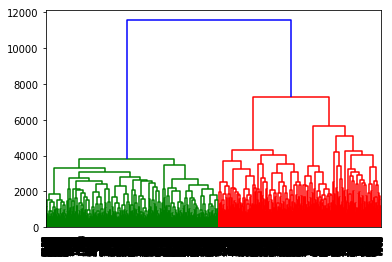

In [90]:
dendrogram(
    Z,
    leaf_rotation=90.,  # rotates the x axis labels
    leaf_font_size=8.,  # font size for the x axis labels
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import pairwise_distances)

In [100]:
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import pairwise_distances

model = AgglomerativeClustering(n_clusters=100,
                                    linkage="average", affinity='cosine')
model.fit(traces)
model.labels_

#     plt.figure()
#     plt.axes([0, 0, 1, 1])
#     for l, c in zip(np.arange(model.n_clusters), 'rgbk'):
#         plt.plot(X[model.labels_ == l].T, c=c, alpha=.5)
#     plt.axis('tight')
#     plt.axis('off')
#     plt.suptitle("AgglomerativeClustering(affinity=%s)" % metric, size=20)

array([ 1,  1,  1, ..., 77,  1, 64])

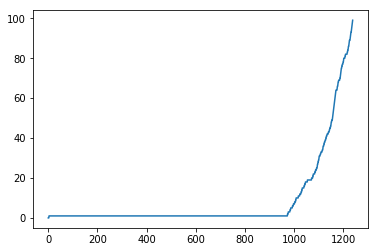

In [101]:
ordering = np.argsort(model.labels_)
plt.plot(model.labels_[ordering])

In [102]:
ordering.shape

(1240,)

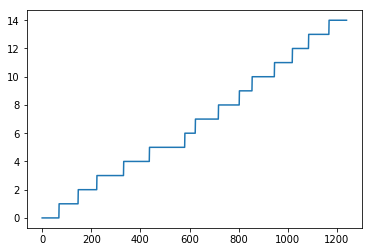

In [131]:
plt.plot(model.row_labels_[np.argsort(model.row_labels_)])

In [75]:
r = c
np.fill_diagonal(r, 0)

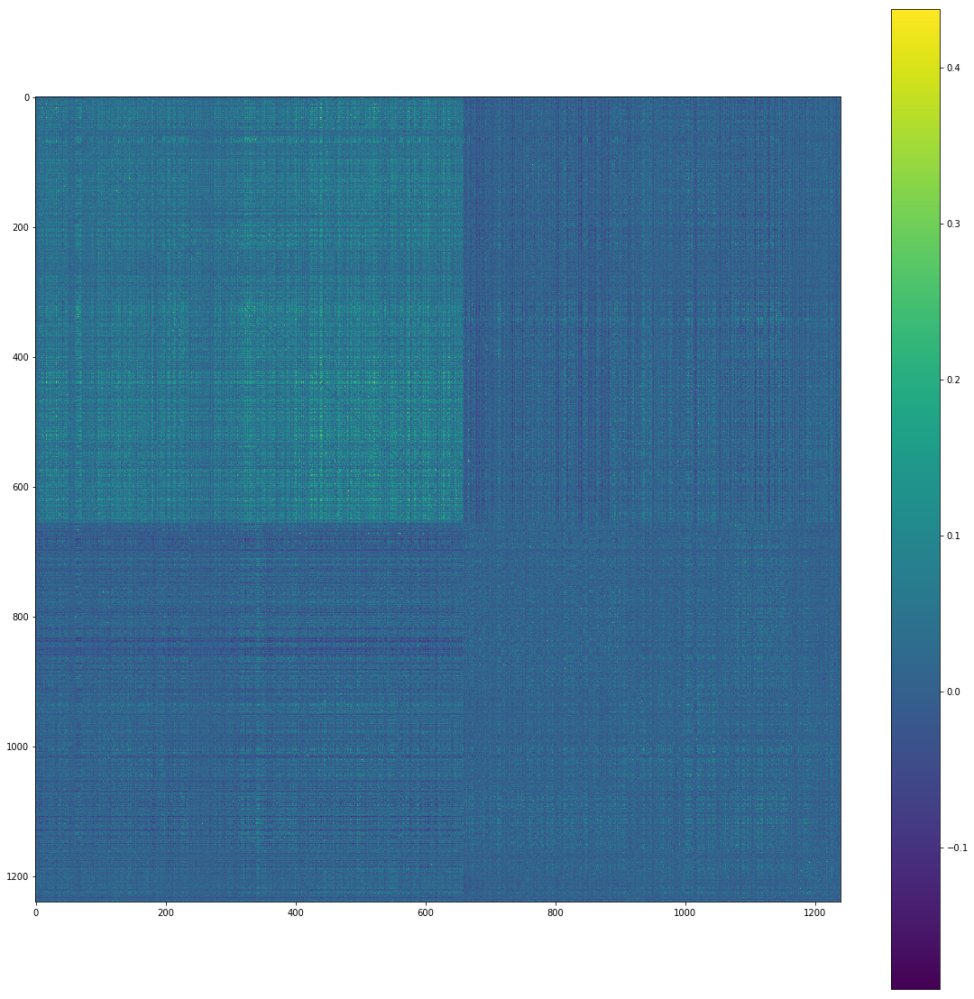

In [78]:
### What is biclustering actually doing??
from sklearn.cluster.bicluster import SpectralCoclustering
from sklearn.cluster import DBSCAN
from sklearn.metrics import consensus_score

data = r

model = SpectralCoclustering(n_clusters=2, random_state=0)
model.fit(data)
fit_data = data[np.argsort(model.row_labels_)]
fit_data = fit_data[:, np.argsort(model.column_labels_)]

# db = DBSCAN(eps=0.3, min_samples=10).fit(data)
# core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
# core_samples_mask[db.core_sample_indices_] = True
# labels = db.labels_
# fit_data = data[np.argsort(db.labels_)]
# fit_data = fit_data[:, np.argsort(db.labels_)]


# np.fill_diagonal(fit_data, 0)
plt.figure(figsize=(20,20))
plt.imshow(fit_data)
plt.colorbar()

In [ ]:
# Try dbscan?

In [125]:
### Plot traces of highly correlated clusters?

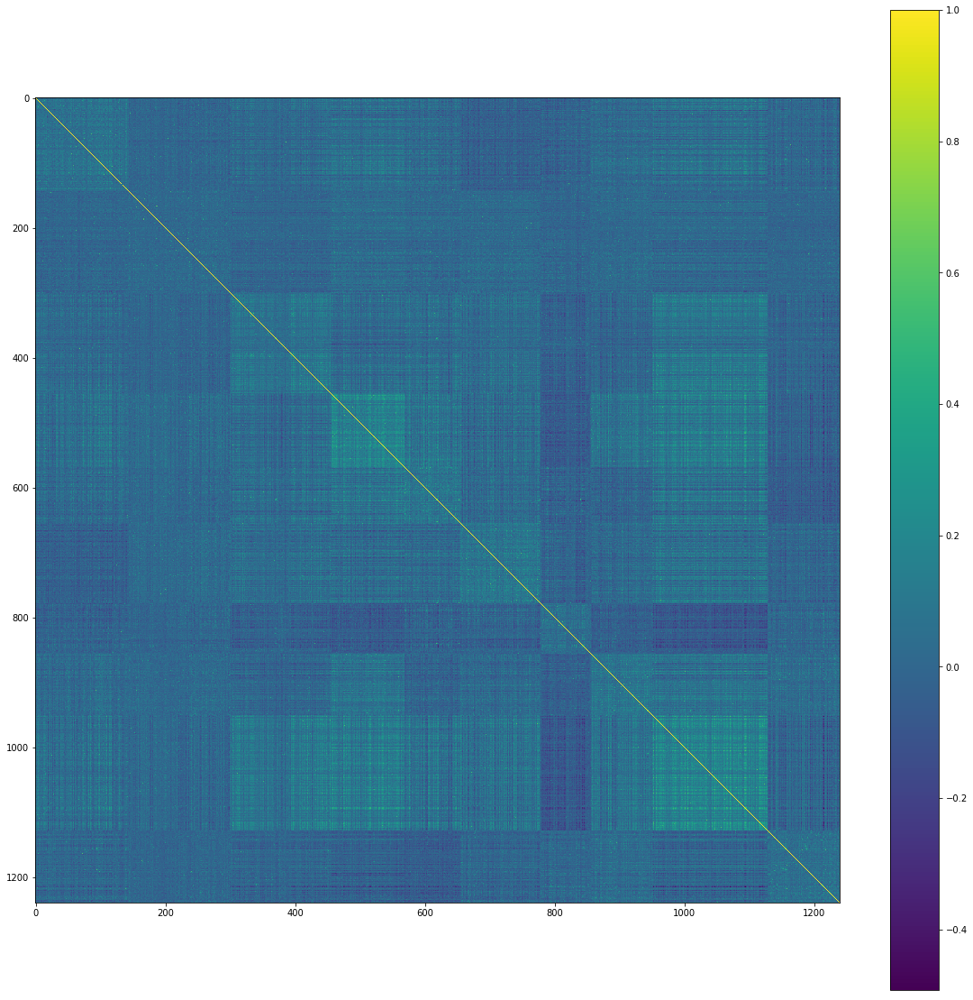

In [ ]:
### NOISE CORRELATION PLOTS>


In [ ]:
### IS there a single dynamics matrix that explains neural activity across cortex. 
### We have the data to compare with visually driven activity. 
### Global brain dynamics of intrinsic dynamics including sensory areas
### Next question: is it causally related.
    

In [ ]:
### Look into fitting an A matrix. 

In [ ]:
### https://web.stanford.edu/~shenoy/GroupPublications/SeeleyEtAlPLoSCompBio2016.pdf

In [ ]:
### Make seeded correlation plots of cellular activity 
### (I don't think anyone has really been able to look at this across cortex like this)

In [ ]:
### If there are correlated cells, then what do they do?

In [ ]:
### Do we want to make a binned 'spikes' trace?

In [ ]:
### You don't necessarilly expect super correlated cells if it is a dynamical system. But, you also may see correlated cells.
### Correlated cells are collinear and reduce the dimensionality. 

In [ ]:
### Make a plot of the first lick time.

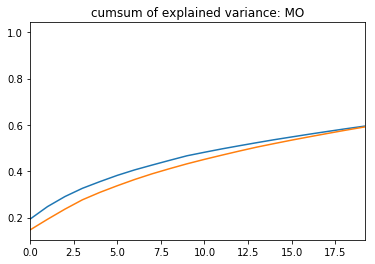

In [11]:
### Make skree plot of PCA. Run PCA on the entire data matrix, CT.C
from sklearn.decomposition import PCA

# for region in ['MO', 'VIS', 'RSP', 'SSp', 'PTLp']:
for region in ['MO']:
    plt.figure()
    for hem in [0, 1]:
        which_cells = np.array(CT.cells_in_region[CT.regions[region]])
        which_cells = which_cells[np.where(CT.hemisphere_of_cell[which_cells]==hem)[0]]
        traces = CT.C[which_cells,:].T

        pca = PCA()
        pca.fit(traces)
        evr = pca.explained_variance_ratio_
        plt.plot(np.cumsum(evr))
        plt.xlim([0, len(evr)*0.2])
    plt.title('cumsum of explained variance: {}'.format(region))

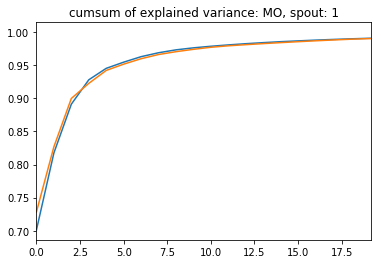

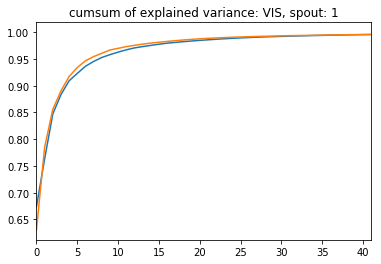

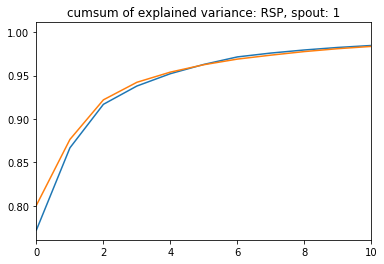

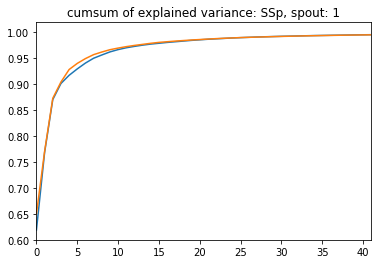

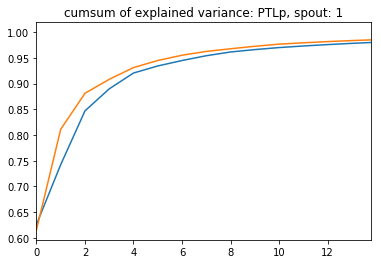

...

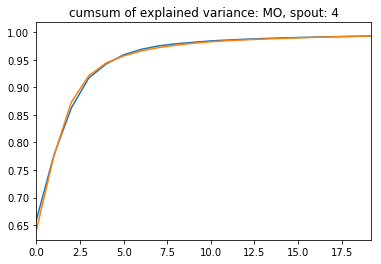

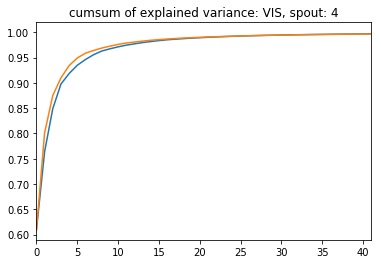

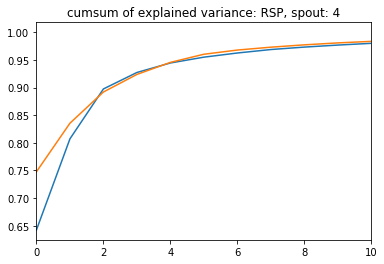

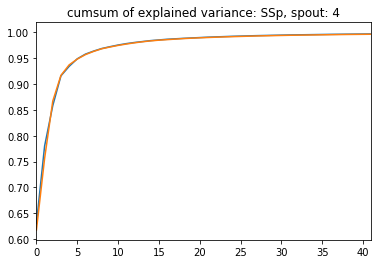

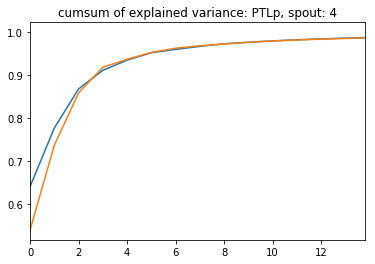

In [12]:
# Look at average trace for each trial type separately
from sklearn.decomposition import PCA

regions = ['MO', 'VIS', 'RSP', 'SSp', 'PTLp']
for spout_position in [1, 3, 4]:
    for region in regions:
        plt.figure()
        for hem in [0, 1]:
            which_cells = np.array(CT.cells_in_region[CT.regions[region]])
            which_cells = which_cells[np.where(CT.hemisphere_of_cell[which_cells]==hem)[0]]
            traces = CT.Ct[which_cells,:,:]

            min_block_trial = 8
            trials = np.logical_and.reduce((BD.go_trials.astype('bool'), 
                                            BD.success, 
                                            BD.spout_positions==spout_position,
                                            BD.ind_within_block>=min_block_trial))
            traces = traces[:,:,np.where(trials[:-1])[0]]
            M = np.mean(traces, axis=2)

            pca = PCA()
            pca.fit(M)
            evr = pca.explained_variance_ratio_
            plt.plot(np.cumsum(evr))
#             plt.plot(evr)
            plt.xlim([0, len(evr)*0.2])
        plt.title('cumsum of explained variance: {}, spout: {}'.format(region, spout_position))

615


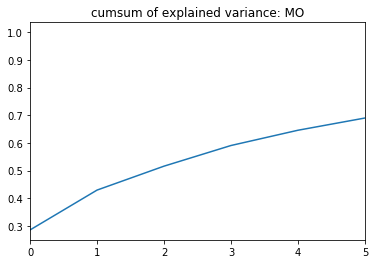

In [76]:
# Look at average trace for trial types appended to one another
# (This is not the same as averaging the PCs appropriately after pca on the whole trace)?

regions = ['MO', 'VIS', 'RSP', 'SSp', 'PTLp']
regions = ['MO']
for region in regions:
    plt.figure()
    for hem in [1]:
        which_cells = np.arange(CT.Ct.shape[0])
#         which_cells = np.array(CT.cells_in_region[CT.regions[region]])
#         which_cells = which_cells[np.where(CT.hemisphere_of_cell[which_cells]==hem)[0]]
        traces = CT.Ft[which_cells,:,:]
        traces = traces - np.expand_dims(np.mean(np.expand_dims(np.mean(traces, 
                                                                        axis=1), 
                                                                axis=1), 
                                                 axis=2), 
                                         axis=2)

        for ind, spout_position in enumerate([1, 3, 4]):
            min_block_trial = 8
            trials = np.logical_and.reduce((BD.go_trials.astype('bool'), 
                                            BD.success, 
                                            BD.spout_positions==spout_position,
                                            BD.ind_within_block>=min_block_trial))
            spout_traces = traces[:,:,np.where(trials[:-1])[0]]
            spout_traces = np.mean(spout_traces, axis=2)
            if ind == 0:
                M = spout_traces
            else:
                M = np.hstack((M, spout_traces))
                

        M = M - np.expand_dims(np.mean(M, axis=1), axis=1)
        pca = PCA()
        weights = pca.fit_transform(M.T)
        evr = pca.explained_variance_ratio_
        components = pca.components_
        plt.plot(np.cumsum(evr))
#         plt.plot(evr)
        print(len(evr))
        plt.xlim([0, len(evr)*0.2])
        plt.xlim([0, 5])
    plt.title('cumsum of explained variance: {}'.format(region))

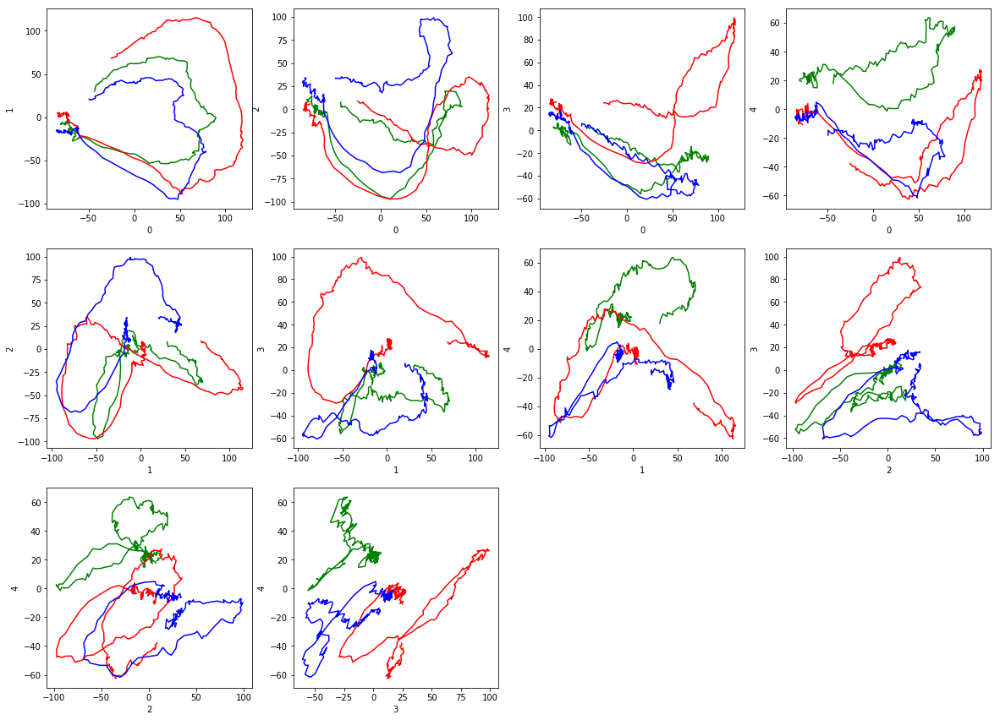

In [75]:
fig = plt.figure(figsize=(20, 20))
iter = 1
for i in np.arange(5):
    for j in np.arange(i+1, 5):
        ax = fig.add_subplot(4,4,iter)
        ax.plot(weights[0:205, i], weights[0:205, j], 'g')
        ax.plot(weights[205:410, i], weights[205:410, j], 'r')
        ax.plot(weights[410:615, i], weights[410:615, j], 'b')
        plt.xlabel(i)
        plt.ylabel(j)
#         plt.title('i {}, j {}'.format(i, j))
        iter = iter + 1

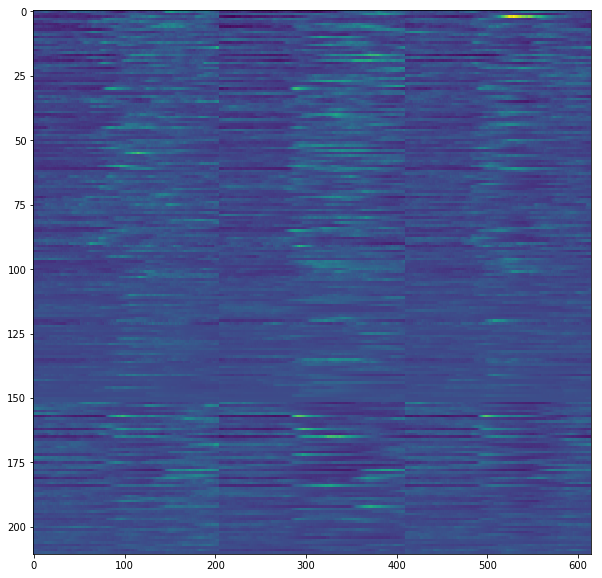

In [64]:
plt.figure(figsize=(10, 10))
plt.imshow(M, aspect='auto')

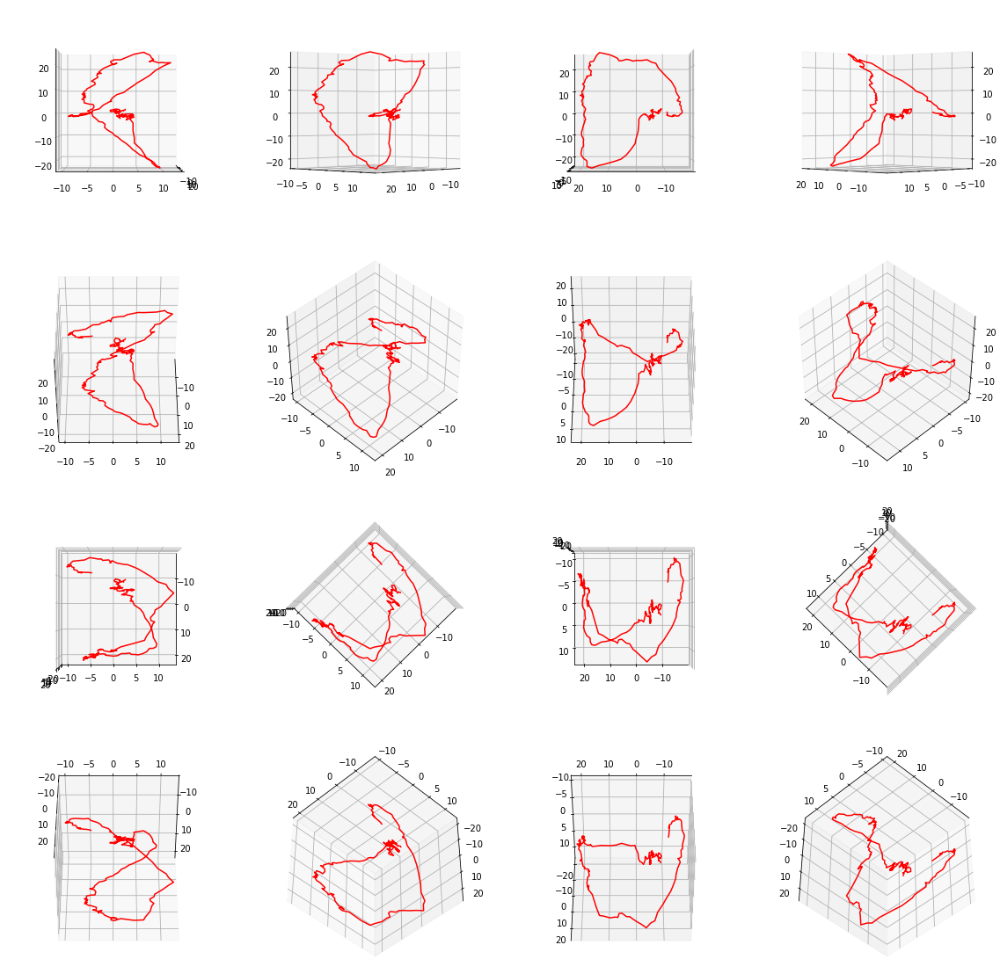

In [37]:
from mpl_toolkits import mplot3d

iter = 1
fig = plt.figure(figsize=(20,20))
for el in [0, 45, 90, 135]:
    for az in [0, 45, 90, 135]:
#         ax = plt.axes(projection='3d')
        ax = fig.add_subplot(4, 4, iter, projection='3d')
        ax.view_init(el, az)

        # Data for a three-dimensional line
#         ax.plot3D(weights[0:205, 1], weights[0:205, 4], weights[0:205, 2], 'g')
        ax.plot3D(weights[205:410, 1], weights[205:410, 4], weights[205:410, 2], 'r')
#          ax.plot3D(weights[410:615, 1], weights[410:615, 4], weights[410:615, 2], 'b')

        iter = iter + 1


# # Data for three-dimensional scattered points
# ax.scatter3D(weights[:,0], weights[:,1], weights[:, 2], c=np.arange(0, weights.shape[0]), cmap='Greens');

In [ ]:
### TODO: Find the discriminatory axes (i.e. based on LDA) 
### (find most discriminative, then most discriminative that is orthogonal to that).
### Then, we can see how much of the variance that accounts for. We know that something
### should be able to discriminate. 
### Maybe this is similar to just fitting a regression model on the lick directions and seeing
### how much variance is captured by that. 

### We really need to understand whether there is anything different behaviorally between the trial types.

In [ ]:
### TODO: Are there trenads in the spatial location of cells depending on which spout was target?

In [ ]:
### Dive into different subsets of trials within a block

In [ ]:
### TODO: Mutual info

In [ ]:
### TODO: Look at different trials within a block


In [ ]:
### TODO: Look at different timepoints within a trial

In [ ]:
### TODO: Netowrk analysis d

In [ ]:
### Are there trial-by-trial correlated hubs? Do some single trial analysis...

In [ ]:
# Delete these below?

In [ ]:
# TODO: CAN WE PULL OUT CELLS THAT DISTINGUISH BETWEEN SPOUTS.
# IF SO, BASED ON WHAT EPOCHS IN THE DATA
# AND WHERE ARE THOSE NEURONS. 

In [ ]:
# Find cells that are more active in one trial condition as opposed to another.
# Provide two sets of trial_inds. Provide a window for computing the response. 



In [ ]:
### Can you cluster cells based on responsiveness to different spouts? 



In [ ]:
### If we run alex william's code, can we pull out temporal factors that look like the location of thetarget spout?


In [ ]:
### Mutual information to different parts of the task

In [ ]:
### Find cells that are more active during one spout vs. the others. 
### Regress cellular activity on spout position. 

Saving to:  /home/izkula/Dropbox/cosmos/trace_analysis/20180227/cux2m72_COSMOSTrainMultiBlockGNG_1/polar_pre-reward-ind-within-block-0.pdf
Saving to:  /home/izkula/Dropbox/cosmos/trace_analysis/20180227/cux2m72_COSMOSTrainMultiBlockGNG_1/polar_pre-reward-ind-within-block-5.pdf
Saving to:  /home/izkula/Dropbox/cosmos/trace_analysis/20180227/cux2m72_COSMOSTrainMultiBlockGNG_1/polar_pre-reward-ind-within-block-10.pdf


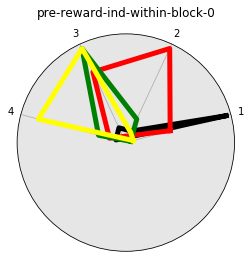

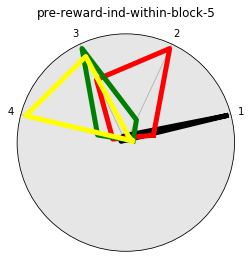

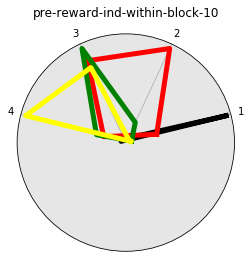

In [10]:
### Plot spout selectivity for different points within a block.
ind_within_block = np.zeros(BD.spout_positions.shape)
iter = 0
for i in range(1, len(ind_within_block)):
    if BD.spout_positions[i] == BD.spout_positions[i-1]:
        iter = iter + 1
    else:
        iter = 0
    ind_within_block[i] = iter
    

spout_trials = dict()
for min_ind_within_block in [0, 5, 10]:
    for i in range(4):
        trial_ind = np.arange(len(BD.spout_positions))
        min_trial = 20
        spout_trials[i] = np.where(np.logical_and.reduce((
                                BD.spout_positions == i+1,
                                ind_within_block >= min_ind_within_block,
                                )))[0]

    t_range = [BD.stimulus_times[0]+1, BD.stimulus_times[0]+1.5] 
    plt.figure()
    BD.polar_lick_plot(spout_trials=spout_trials, t_range=t_range, 
                    plot_trace=False, 
                    save_name='pre-reward-ind-within-block-'+
                               str(min_ind_within_block))

### TODO: plot vs. various ITIs
# BD.iti_lengths

In [16]:
def get_group_mean_traces(traces, 
                          normalize=False):
    """
    Computes the mean and sem trace for groups of traces.
    :param traces: dict. key=group name, entry:[item x time] array of traces
                   For example, each entry can be a brain region, and the entries
                   are an array with the trial averaged traces for each cell.
                   Or, each entry is a cell, and the entries are an array with 
                   the trace on each trial for that cell. 
    :param normalize: bool. Whether to normalize all traces 
                      before computing the mean. Subtract means
                      and divides by max. (Should you zscore?)
    :returns mean_traces: dict. key=group name. entry: ndarray - the mean trace
    :returns sem_traces: dict. key=group name. entry: ndarray - the standard error trace
    """
    
    mean_traces = dict()
    sem_traces = dict()
    for group, group_trace in traces.items():
        if normalize:
            trace_min = np.expand_dims(np.percentile(group_trace, 15, axis=1), axis=1)
            group_trace = group_trace - trace_min
            trace_max = np.expand_dims(np.max(group_trace, axis=1), axis=1)
            group_trace = group_trace/trace_max

        mean_traces[group] = np.median(group_trace, axis=0)
        sem_traces[group] = scipy.stats.sem(group_trace, axis=0)
    
    return mean_traces, sem_traces
    
def plot_mean_traces(traces, t, do_err_bar=True, 
                     do_normalize_before_mean=False, 
                     cmap=None, event_times=None, 
                     fig_save_dir=None, save_name=None, 
                     save_suffix='.pdf'):
    """
    Computes and plots the mean trace for groups of traces. 
    :param traces: dict. key=group name, entry:[item x time] array of traces
                   For example, each entry can be a brain region, and the entries
                   are an array with the trial averaged traces for each cell.
                   Or, each entry is a cell, and the entries are an array with 
                   the trace on each trial for that cell. 
                   Or, each entry is a trial, and the entries are are an array
                   with the trace for each cell on that trial. 
    :param t: array. time axis. 
    :param err_bar: bool. Whether to plot error bars (as standard error of mean).
    :param do_normalize_before_mean: bool. Whether to normalize all traces 
                                     before computing the mean. Subtract means
                                     and divides by max. (Should you zscore?)
    :param cmap: colormap for plotting the traces. Default: plt.cm.hsv
    :param event_times: Times at which to plot vertical lines. (Same
                        units as the 't' parameter).
   # :param fig_save_dir: If provided, will save figure to this location. 
   # :param save_name: Additional information for the saved out filename.
   # :param save_suffix: '.pdf' or '.png'
    """
    
    group_means, group_sems = get_group_mean_traces(traces, 
                                    normalize=do_normalize_before_mean)    
    ngroups = len(group_means.keys())
    group_names = []
    ind = 0
    for group, mean_trace in group_means.items():
        plt.plot(t, mean_trace, color=cmap(ind / float(ngroups)))
        if do_err_bar:
            errbar = group_sems[group]
            plt.fill_between(t, mean_trace-errbar,
                             mean_trace+errbar, 
                             facecolor=cmap(ind/float(ngroups)),
                             alpha=0.5)
        ind = ind + 1
        group_names.append(group)
    
    plt.legend(group_names, bbox_to_anchor=(1.04,1), loc="upper left")
    for event_time in event_times:
        plt.axvline(event_time, color='k', linestyle='--')

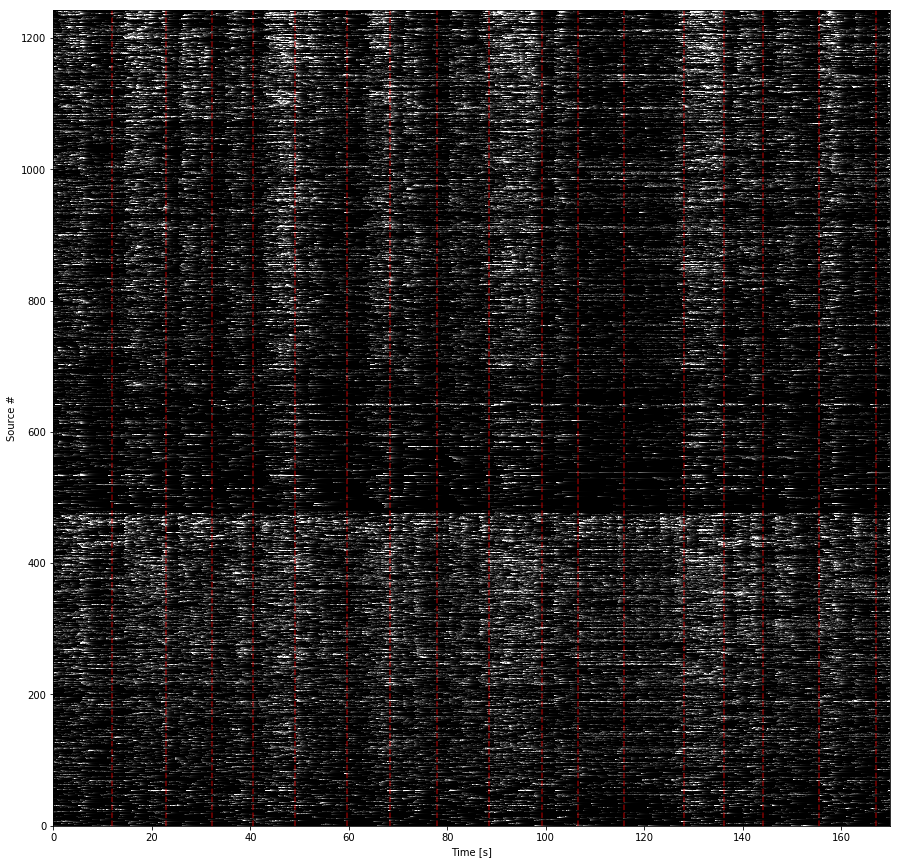

In [14]:
plt.figure(figsize=(15,15))
fstart = 0
fend = 5000
plt.imshow(CT.C[:,fstart:fend], aspect='auto', 
           cmap=plt.cm.gray, clim=[0, 50],
           extent=[0, (fend-fstart)/CT.fps, 0, CT.C.shape[0]])
for f in CT.led_frames:
    plt.axvline((f-fstart)/CT.fps, color='r', linestyle='--', alpha=0.5)
plt.xlim([fstart, fend]/CT.fps)
plt.xlabel('Time [s]')
plt.ylabel('Source #')
plt.savefig(os.path.join(CT.fig_save_path, 'raster.png'))

###TODO color this by region?

In [19]:
def zscore_3d(C):
    """
    Zscores a 3D matrix across the last two dimensions
    i.e. [cells x time x trials]
    for each cell, zscores all trials and timepoints by
    the mean and stdev across trials and timepoints
    """
    print(C.shape)
    m = np.percentile(np.percentile(C, 10, axis=1), 10, axis=1)
    m = m[:, np.newaxis, np.newaxis]
    m = np.tile(m, (1, C.shape[1], C.shape[2]))

    s = np.std(np.std(C, axis=1), axis=1)
    s = s[:, np.newaxis, np.newaxis]
    s = np.tile(s, (1, C.shape[1], C.shape[2]))
    C_z = (C - m)/s
    return C_z

In [ ]:
### Trim down plotting of traces according to a specified order, so it can be
### put in a function that takes in a trial_type and a list of cells to include. 









--- 1.3207476139068604 seconds ---
--- 1.387430191040039 seconds ---
--- 2.5 seconds ---
--- 1.8427999019622803 seconds ---
--- 3.0985941886901855 seconds ---
--- 1.4695022106170654 seconds ---
--- 1.4940781593322754 seconds ---
--- 2.455833673477173 seconds ---
--- 2.0490455627441406 seconds ---
--- 3.2748003005981445 seconds ---


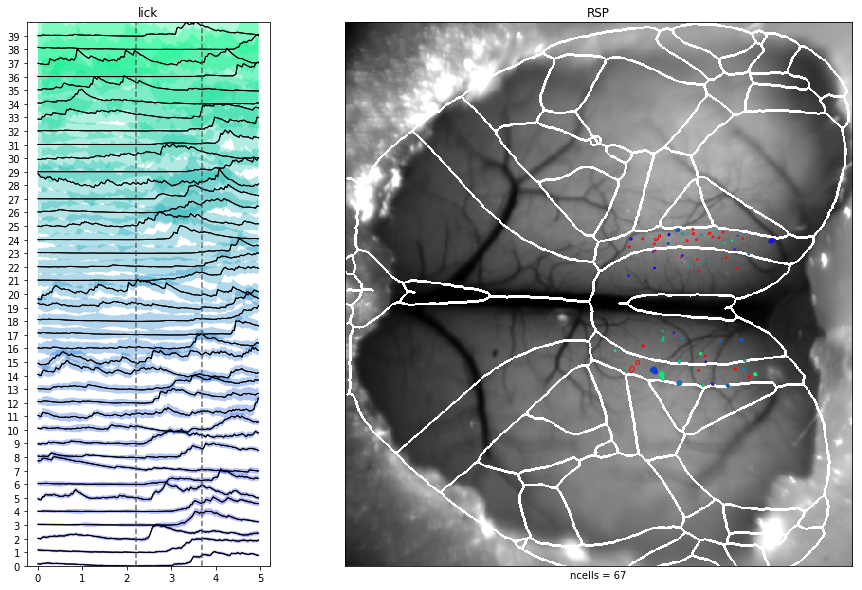

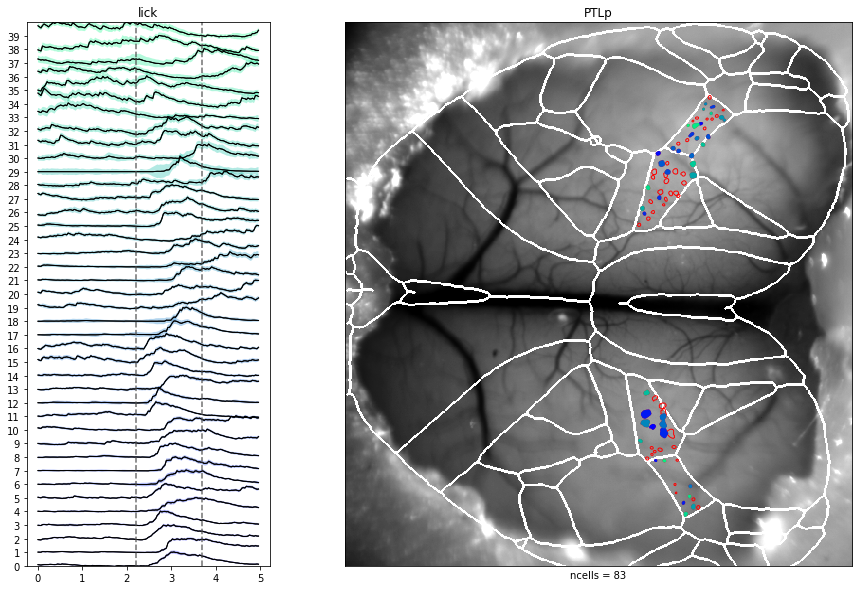

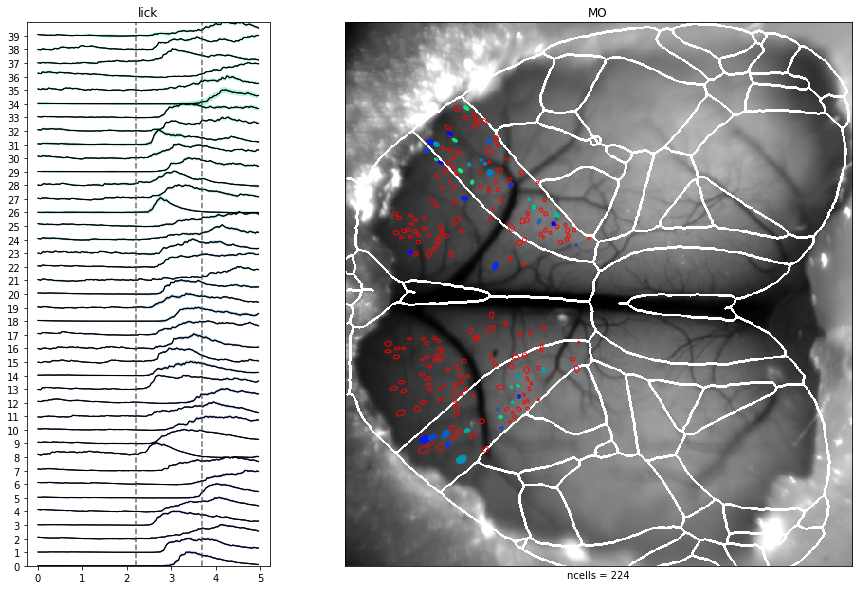

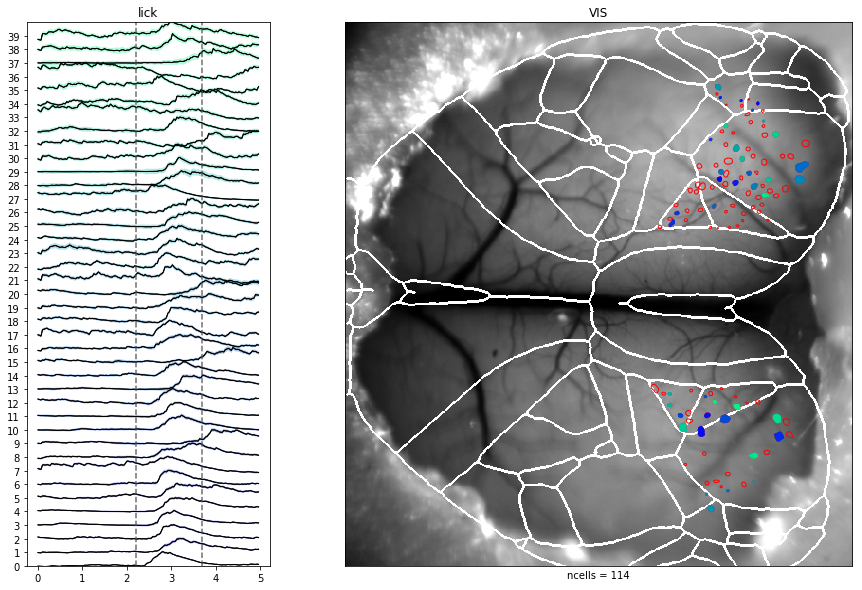

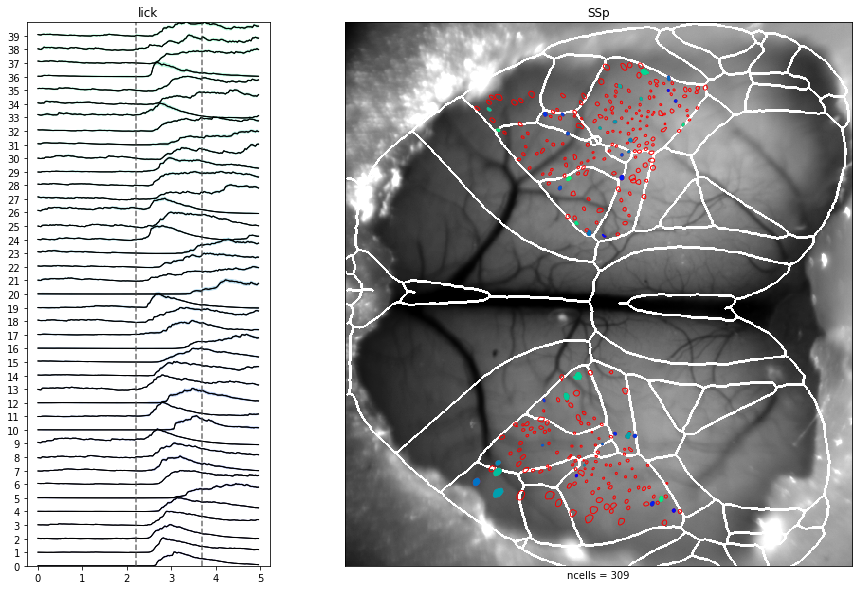

...

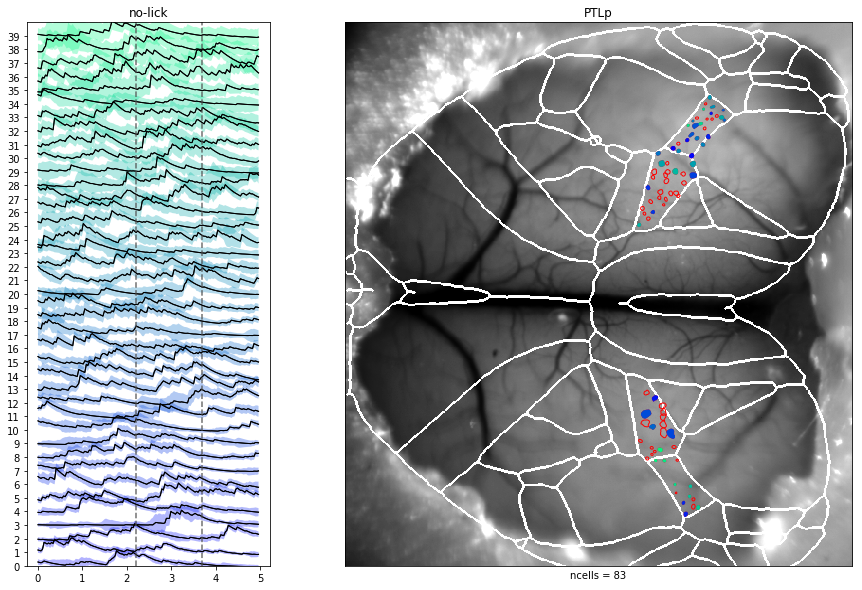

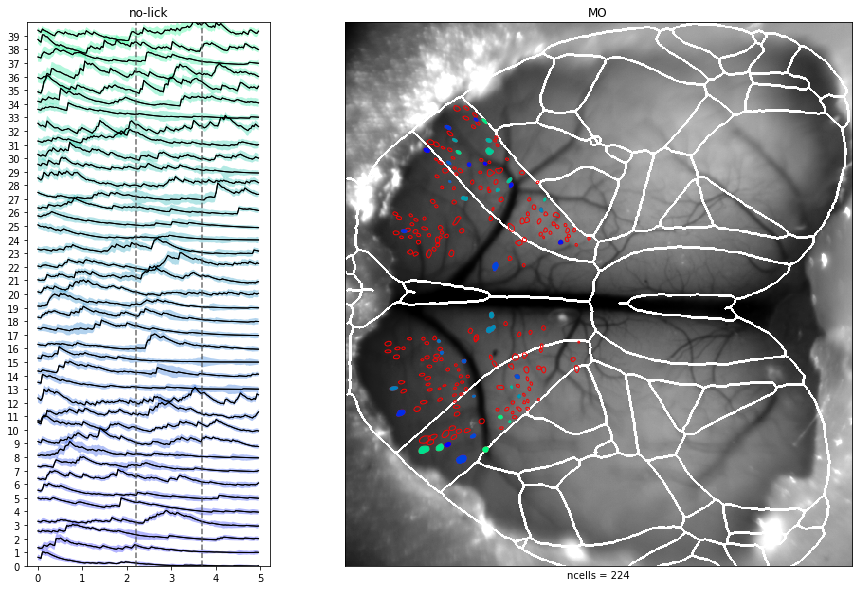

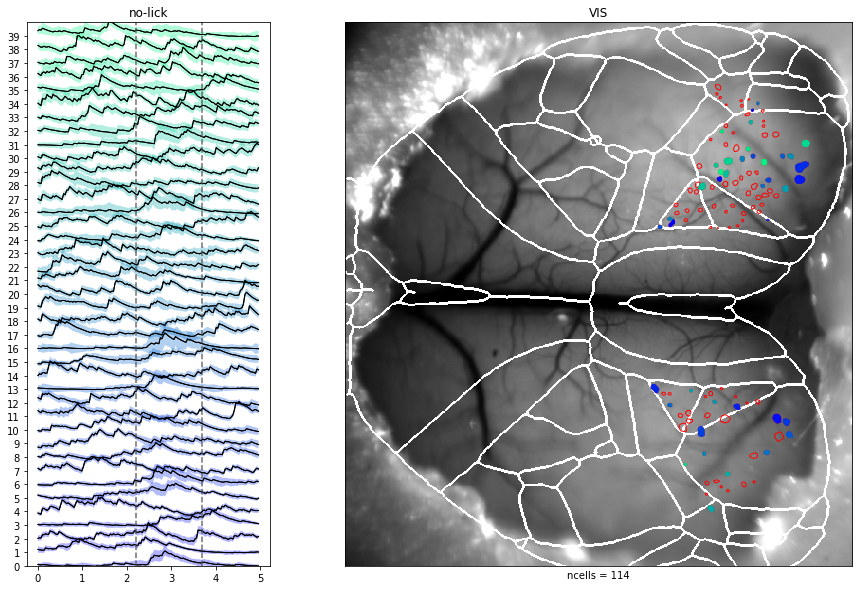

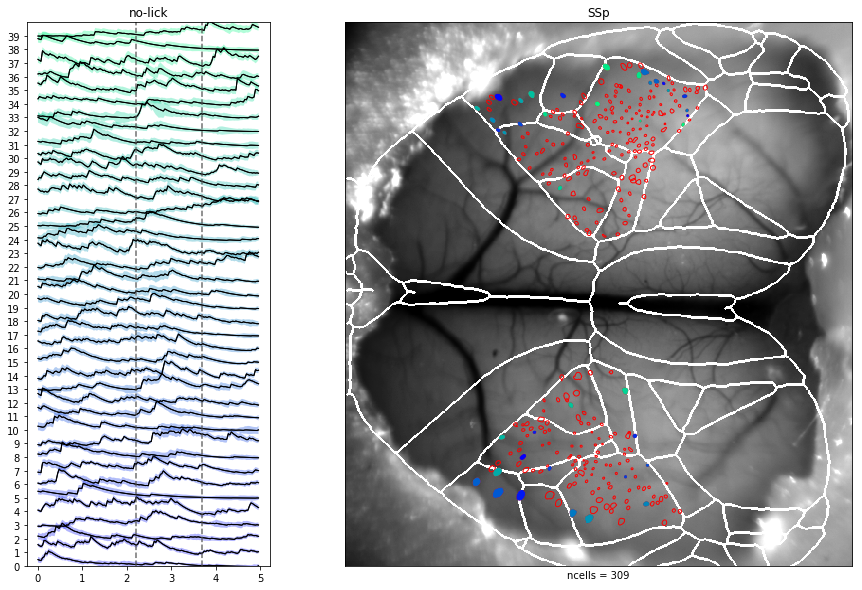

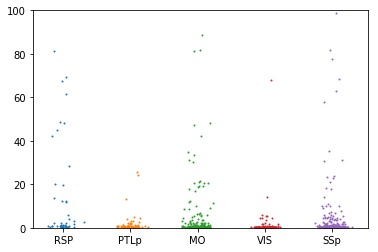

In [22]:
### Make various plots that aggregate cells within a region. 

for trial_type in ['lick', 'no-lick']:
    if trial_type == 'lick':
        which_trials = lick_trials
    if trial_type == 'no-lick':
        which_trials = no_lick_trials

    ### Generate dictionary with traces for the cells within each region.
    regional_trial_means = dict()
    regional_trial_sems = dict()
    regional_footprints = dict()
    which_region_ids = [322, 500, 22, 669, 254]
        
#     which_region_ids = [500]
    for ind, region in enumerate(which_region_ids):
        annotation = annotations[str(region)]
        name = annotation['acronym'].decode('utf-8')

        which_cells = cells_in_region[region]
        C_region = Ct[which_cells, :, :][:,:,which_trials]
#         good_cells = #TODO
        
        ### zscore within each trial 
        do_zscore = False
        if do_zscore:
            m = np.percentile(np.percentile(C_region, 15, axis=0), 15, axis=0)
            m = np.tile(m, (C_region.shape[0], C_region.shape[1], 1))
            s = np.std(np.std(C_region, axis=0), axis=0)
            s = np.tile(s, (C_region.shape[0], C_region.shape[1], 1))
            C_z = (C_region - m)/s 
            C_region = C_z
        
        trial_mean = np.median(C_region, axis=2)
        trial_sem = scipy.stats.sem(C_region, axis=2)
        footprints = ff[:,:,which_cells]

        regional_trial_means[name] = trial_mean
        regional_trial_sems[name] = trial_sem
        regional_footprints[name] = footprints

        
        
#     ### TODO: Plot ordered normalized traces
#     do_plot_order_normalized_traces = True
#     if do_plot_ordered_normalized_traces:
        
    ### For all regions, plot trial mean traces.
    ### Order cells based on their variation across trials.
    do_plot_regional_cells = True
    if do_plot_regional_cells:
        for region in regional_trial_means.keys():
            trial_mean = regional_trial_means[region]
            trial_sem = regional_trial_sems[region]
            footprints = regional_footprints[region]

            ### Plot the neurons with the smallest relative standard error        
            cell_scale_factor = (np.max(trial_mean,axis=1) - 
                                np.percentile(trial_mean, 15, axis=1))
            cell_sem = np.median(trial_sem, axis=1)
            which_cells = np.argsort(cell_sem/cell_scale_factor) 
#             which_cells = np.argsort(cell_sem) 

            
            fig = plt.figure(figsize=(20,10))
            CP = CellPlotter(trial_mean, trial_mean, footprints, 
                             base_im, spikes=None,
                             errbar=trial_sem,
                             date='Regional traces', name=region, 
                             fig_save_path=fig_save_path, 
                             suffix=region+'-'+trial_type+'.png',
                             cmap=plt.cm.winter)

            nneurons = 40
            CP.set_highlighted_neurons(which_cells[0:nneurons])

            event_frames = fps*np.array([BD.stimulus_times[0], 
                                         BD.stimulus_times[0]+1.5])
            CP.plot_traces(n_timepoints=trial_mean.shape[1], \
                           ax=plt.subplot(142), \
                           ### Even though only two plots, using subplot(142) 
                           ### squeezes the trace plot to improve aesthetics.
                           save_plot=False, \
                           event_frames=event_frames, \
                           dt=dt)
            plt.title(trial_type)
            CP.plot_contours(highlight_neurons=True, \
                             display_numbers=False, 
                             ax=plt.subplot(122),
                             atlas_outline=aligned_atlas_outline,
                             maxthr=0.8)  

    ### Overlay the mean trace across cells for each regions.
    do_plot_regional_mean = False
    if do_plot_regional_mean:
        event_times = [BD.stimulus_times[0], 
                       BD.stimulus_times[0]+1.5]
        plt.figure()
        plot_mean_traces(regional_trial_means, 
                         t, do_err_bar=True, 
                         do_normalize_before_mean=True, 
                         cmap=plt.cm.hsv, 
                         event_times=event_times)

        plt.title('Normalized trial-averaged median across cells per region')

        fig_save_dir = os.path.join(fig_save_path, 'Regional traces')
        if not os.path.isdir(fig_save_dir): os.makedirs(fig_save_dir)
        save_name = 'regional_average'

        plt.savefig(os.path.join(fig_save_dir,  save_name+'-' + trial_type + '.pdf'),
                    bbox_inches='tight')

    ### Scatter plot of variance within each region.
    ### TODO: Double check this...  IS THIS CORRECT?
    ### SEEMS LIKE NEEDS SOME FIXING SOMEWHERE.
    do_plot_regional_sems = True
    if do_plot_regional_sems:
        plt.figure()
        ind = 0
        labels = regional_trial_sems.keys()
        x = np.arange(len(labels))
        data = []
        for region, trial_sems in regional_trial_sems.items():
            scale_factor = (np.max(regional_trial_means[region], axis=1) -
                            np.min(regional_trial_means[region], axis = 1))
            cell_sems = np.median(trial_sems, axis=1)/scale_factor
            
            xx = np.random.normal(x[ind], 0.1, len(cell_sems))
            plt.scatter(xx, cell_sems, s=1)
            data.append(cell_sems)
            ind = ind + 1
#         plt.boxplot(data)
        plt.xticks(x, labels, rotation='horizontal')
        plt.ylim([0, 100])

In [200]:
def vcorrcoef(X,y):
    """
    Compute correlation between each row of X and y
    """
    Xm = np.reshape(np.mean(X,axis=1),(X.shape[0],1))
    ym = np.mean(y)
    r_num = np.sum((X-Xm)*(y-ym),axis=1)
    r_den = np.sqrt(np.sum((X-Xm)**2,axis=1)*np.sum((y-ym)**2))
    r = r_num/r_den
    return r

plt.plot(np.median(vcorrs[which_cells,:], axis=1))

/home/izkula/anaconda/envs/cosmos3/lib/python3.5/site-packages/ipykernel_launcher.py:9: RuntimeWarning: invalid value encountered in true_divide
  if __name__ == '__main__':
/home/izkula/anaconda/envs/cosmos3/lib/python3.5/site-packages/numpy/lib/function_base.py:4033: RuntimeWarning: Invalid value encountered in median for 3 results
  r = func(a, **kwargs)


--- 2.5318443775177 seconds ---


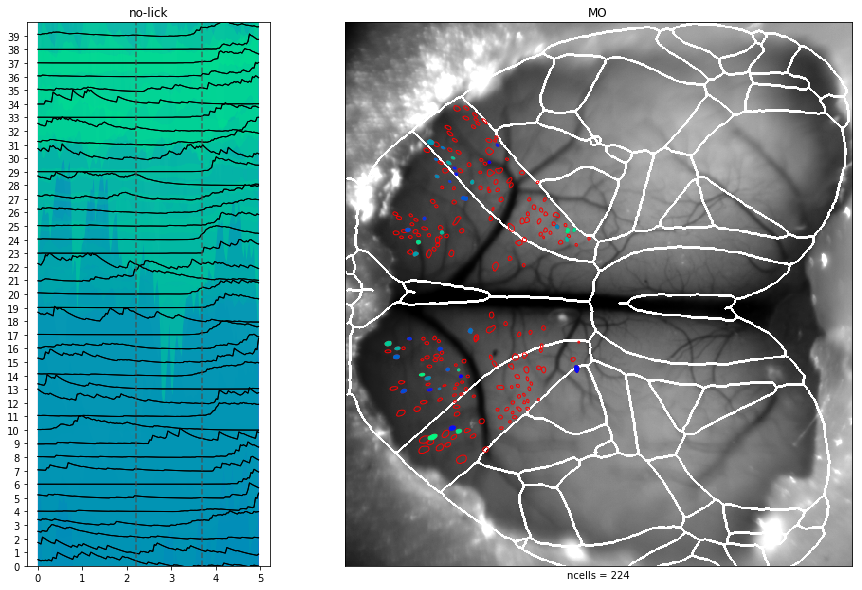

In [239]:
### Try correlation metric (instead of sem).

which_trials = lick_trials

### Generate dictionary with traces for the cells within each region.
regional_trial_means = dict()
regional_trial_sems = dict()
regional_footprints = dict()
# which_region_ids = [322, 500, 22, 669, 254]

which_region_ids = [500]
for ind, region in enumerate(which_region_ids):
    annotation = annotations[str(region)]
    name = annotation['acronym'].decode('utf-8')

    which_cells = cells_in_region[region]
    C_region = Ct[which_cells, :, :][:,:,which_trials]
    t = T
    
    ### Generate correlation template
    template = np.zeros((len(t)))
    stim_time = BD.stimulus_times[0]
    inds = np.where(np.logical_and(t > stim_time, t < stim_time+1.5))[0]
    template[inds] = 1
            
    vcorrs = np.zeros((C_region.shape[0], C_region.shape[2]))
    for trial in range(C_region.shape[2]):
        X = C_region[:,:,trial]
        vcorrs[:, trial] = vcorrcoef(X, template)

    which_cells = np.argsort(np.median(vcorrs, axis=1))

    trial_mean = np.median(C_region, axis=2)
    trial_sem = scipy.stats.sem(C_region, axis=2)
    footprints = ff[:,:,which_cells]

    regional_trial_means[name] = trial_mean
    regional_trial_sems[name] = trial_sem
    regional_footprints[name] = footprints

        
    ### For all regions, plot trial mean traces.
    ### Order cells based on their variation across trials.
    do_plot_regional_cells = True
    if do_plot_regional_cells:
        for region in regional_trial_means.keys():
            trial_mean = regional_trial_means[region]
            trial_sem = regional_trial_sems[region]
            footprints = regional_footprints[region]

            ### Plot the neurons with the smallest relative standard error        
#             cell_scale_factor = (np.max(trial_mean,axis=1) - 
#                                 np.percentile(trial_mean, 15, axis=1))
#             cell_sem = np.median(trial_sem, axis=1)
#             which_cells = np.argsort(cell_sem/cell_scale_factor) 

#             which_cells = np.argsort(cell_sem) 
            which_cells = np.argsort(np.median(vcorrs, axis=1))


            
            fig = plt.figure(figsize=(20,10))
            CP = CellPlotter(trial_mean, trial_mean, footprints, 
                             base_im, spikes=None,
                             errbar=trial_sem,
                             date='Regional traces', name=region, 
                             fig_save_path=fig_save_path, 
                             suffix=region+'-'+trial_type+'corr.png',
                             cmap=plt.cm.winter)

            nneurons = 40
            CP.set_highlighted_neurons(which_cells[0:nneurons])

            event_frames = fps*np.array([BD.stimulus_times[0], 
                                         BD.stimulus_times[0]+1.5])
            CP.plot_traces(n_timepoints=trial_mean.shape[1], \
                           ax=plt.subplot(142), \
                           ### Even though only two plots, using subplot(142) 
                           ### squeezes the trace plot to improve aesthetics.
                           save_plot=False, \
                           event_frames=event_frames, \
                           dt=dt)
            plt.title(trial_type)
            CP.plot_contours(highlight_neurons=True, \
                             display_numbers=False, 
                             ax=plt.subplot(122),
                             atlas_outline=aligned_atlas_outline,
                             maxthr=0.8)  


In [ ]:
### TO DO: Make a class for plotting a single cell:
### Plot all trials, (for different conditions), footprint location, 
### average trace with errorbar for the different conditions.

In [ ]:
### TODO: taskSelectiveCOSMOS(allSpikeData(whichRows, :), dt, 0.05, baseline, 'bootstrap', taskInds))
### /home/izkula/src/COSMOS/matlab/scripts/trace_analysis.m

In [ ]:
### TODO TODO TODO
### ALSO - LOOK AT WHAT TIM HAS ALREADY CODED.
### Need a trace analysis class. 
### Will contain these functions:
    ### - Convert to trial structure
    ### - Compute mutual information of each neuron. Input: trial traces for each neuron, 
    ###      trial labels (this could be whatever you want)
### Format traces into a [cell x time x trial] matrix.

In [ ]:
### Compute mutual information between 
### 1) The neural data and the current trial type.
### 2) Neural data and the previous trial type.
### 3) Do this as a function of trial number within a block.

Mutual information is the amount of information that can be extracted from the firing
rate of a neuron R, about the task-related parameter X. 
$$I(X, R) = \sum_x P(x) \sum_r P(r, x) log_2 \frac{P(r|x)}{P(r)}$$
where $P(r|x)$ is the conditional probability of observing a neuronal response $r$ given the presentation of the task parameter x; $P(r)$ is the marginal probability of occurrence of neuronal response $r$ among all possible responses, and $P(x)$ is the probability of task parameter $x$.

This definition quantifies how well an ideal observer can discriminate between members of a stimulus set on the basis of the neuronal responses of a single trial. 

For each trial, neuronal response was defined as the rate of spiking during a time window of 100ms. 
The conditional probability is estimated from a number of experimental trials for each stimulus. 

To correct an upward bias in the estimate of mutual information, they used the quadratic extrapolation method, which assumes that bias can be accurately approximated as second order expansions in 1/N. 

Then they compared with bootstrap shuffling of the pairing stimuli and responses to destroy the relevant information. The bootstrapped information value is treated as the residual bias of the information calculation and subtracted out. 


In [ ]:
#### TODO: For each neuron, across all trials of a given type (or previous trial of a given type)
#### Estimate P(x), P(r, x), P(r|x), P(r)
### But r is continuous?

In [ ]:
### Plot traces and contours for cells in each region
do_traces = True
do_contours = True
do_seconds = True
n_timepoints = 4000
which_region_ids = [322, 500, 22, 669, 254]
for region in which_region_ids:
    cell_ids = np.array(cells_in_region[region])
    annotation = annotations[str(region)]
    name = annotation['acronym'].decode('utf-8')
    CP = CellPlotter(C, F, ff, base_im, date='Regional traces', name=name, 
                           fig_save_path=fig_save_path, suffix=name+'.png')
    CP.set_highlighted_neurons(cell_ids[0:min(len(cell_ids),100)])
    fig = plt.figure(figsize=(20,10))
    if do_traces:
        if do_seconds:
            dt = 1.0/34
        else:
            dt = 1
        CP.plot_traces(n_timepoints=n_timepoints, \
                       ax=plt.subplot(121), \
                       save_plot=False, \
                       event_frames=led_frames, \
                       dt=dt)
    if do_contours:
        CP.plot_contours(highlight_neurons=True, \
                         display_numbers=False, 
                         ax=plt.subplot(122),
                        atlas_outline=aligned_atlas_outline)

In [ ]:
#### Regress spike counts on spout position. 

In [179]:
def plot_trials_overlay_per_source(traces, which_trials, dt):
    """
    Overlays time-aligned traces for each source. 
    :param traces: [ncells x ntimepoints x ntrials]
    :param which_trials: bool array of length ntrials. 
    """
    
    ncells = 50 #traces.shape[0]
    trial_inds = np.where(which_trials)[0]
    ntrials = len(trial_inds)
    t = dt*np.arange(traces.shape[1])
    plt.figure(figsize=(20, 20))
    for cell in range(ncells):
        for trial in trial_inds:
            plt.plot(t, utils.normalize(np.squeeze(traces[cell, :, trial]), percentile=False) + cell, 'k')
    
#                 t = dt*np.arange(nt)
#             plt.plot(t,normalize(self.traces_raw[idx, :nt]) + iter, 'k')
#             plt.plot(t,normalize(self.traces[idx, :nt]) + iter, 'b')
#             if self.spikes is not None:
#                 plt.plot(t, normalize(self.spikes[idx, :nt], 
#                                          percentile=False) + iter, 'r')
#         plt.ylim([0, len(self.neuron_ind)])
#         ax.get_yaxis().set_ticks(np.arange(len(self.neuron_ind)))
    

In [ ]:
### Find cells that are more active during one spout vs. the others. 
### Regress cellular activity on spout position. 
def spout_selective(S, BD.spout_positions, BD.trial_types):
    pass

In [229]:
import scipy.stats
def task_selective(St, task_engaged_trials, baseline_inds, task_inds, stat_type='ttest', pval=0.01):
    """
    Find cells that are more active during cue period vs. during baseline. 

    :param St: deconvolved spikes. [ncells x ntimepoints x ntrials]
    :param task_engaged_trials: np.array indicating trials on which
                                the mouse was actively licking. 
    :param baseline_inds: np.arange of indices specifying frames during the baseline
    :param task_inds: np.arange of indices specifying frames during the task (i.e. cue period)
    """
    print(St.shape)
    ncells = St.shape[0]
    pvals = np.zeros((ncells,1))
    task_means = np.zeros((ncells, 1))
    baseline_means = np.zeros((ncells, 1))
    for cell in range(ncells):
        baseline_mean = np.mean(np.squeeze(St[cell, baseline_inds, :]), axis=0)
        task_mean = np.mean(np.squeeze(St[cell, task_inds, :]), axis=0)
        _, p = scipy.stats.ttest_ind(baseline_mean, task_mean) 
        pvals[cell] = p
        baseline_means[cell] = np.mean(baseline_mean)
        task_means[cell] = np.mean(task_mean)
#     print(task_mean)
#     print(baseline_mean)
    return pvals < pval, baseline_means, task_means


In [230]:
task_engaged_trials = np.where(~np.isnan(BD.reward_times[0:St.shape[2]]))[0]
baseline_inds = np.arange(int((BD.stimulus_times[0]-1)/dt), int(BD.stimulus_times[0]/dt))
task_inds = np.arange(int(BD.stimulus_times[0]/dt), int((BD.stimulus_times[0]+1)/dt))
ts, baseline_means, task_means = task_selective(St, task_engaged_trials, baseline_inds, task_inds)
ts_cells = np.where(np.logical_and(ts, task_means > baseline_means))[0]

(1295, 169, 181)
